# Stable Storyboards

[Link to the dataset and the project materials](https://drive.google.com/drive/folders/1u_s8s3ieTVY9DIM7YbwEUR2JX7MHBtCL?usp=sharing)

## Introduction
This project presents Stable Storyboards - a new way to create storyboards for the film and video industry which has the potential to make them more authentic to the true concept of the authors and to dramatically cut time and cost for their making. All that is made possible by utilising the benefits of the Stable Diffusion XL model (and with a little help from the HuggingFace ecosystem).

Stable Storyboards is an upgrade of the current state of affairs of storyboard making because it is much more flexible and available for customisation. By implementing simple Low-Rank Adaptation (LoRA) and fine-tuning (Dreambooth) techniques, we are now ready to create storyboards which are much more connected to the specifics of the videomaking project and the ideas behind it.


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


### What is a storyboard?

Storyboards are used by the film, media and advertising industries as graphic organizers that consist of illustrations or images displayed in sequence for the purpose of pre-visualizing a motion picture, animation, motion graphic or interactive media sequence.


According to [Wikipedia](https://en.wikipedia.org/wiki/Storyboard), "the storyboarding process, in the form it is known today, was developed at Walt Disney Productions during the early 1930s, after several years of similar processes being in use at Walt Disney and other animation studios."

In [ ]:
from PIL import Image
import glob
def image_grid(imgs, rows, cols, resize_w=384, resize_h=512):
    #assert len(imgs) == rows * cols

    if resize_w is not None:
        imgs = [img.resize((resize_w, resize_h)) for img in imgs]

    w, h = imgs[0].size
    grid_w, grid_h = cols * w, rows * h
    grid = Image.new("RGB", size=(grid_w, grid_h))

    for i, img in enumerate(imgs):
        x = i % cols * w
        y = i // cols * h
        grid.paste(img, box=(x, y))

    return grid

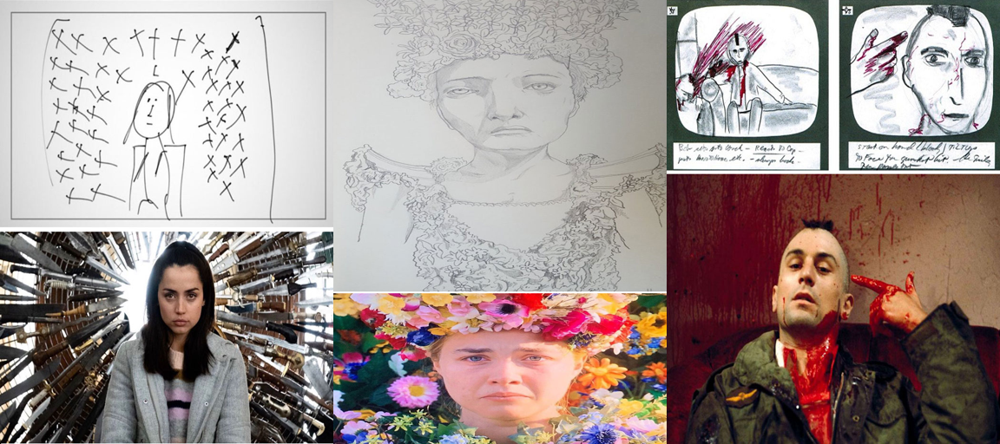

In [ ]:
storyboards_path = "/content/drive/MyDrive/stable-storyboards/ugly_storyboards"
imgs = [Image.open(path) for path in glob.glob(storyboards_path+'/*.jpg')]
image_grid(imgs, 1, 3)

### The problems.
Storyboards have indeed not changed much since the 1930s...
At the moment, storyboards range from sets of cartoon-ish images which have little to do with the visual style of the production to scrappy pen drawings on the back of scripts and other production papers.

Nowadays, storyboards still:
- look very differently from the desired end product - these basic cartoon characters can hardly resemble the presence of actors like Florence Pugh or Robert De Niro;
- look very similar to one another, regardless of the project and its specifics;
- take a lot of time, money, specific skills and (human) effort to make.

### A possible solution.

This paper demonstrates how video storytellers can use AI to turn their shotlists into storyboards that look much closer to the original idea of the authors by incorporating real actors and customized visual styles into their images.

This can be achieved without the need to wait days or even weeks for a person with a specific skillset to create them. By the way, that person probably doesn't work for free.

All this would help video storytellers present and communicate their ideas with the rest of the team more efficiently and quickly.
Furthermore, Stable Storyboards can be used as a tool for prototyping different visual ideas, which will also save a lot of time and hustle of everybody involved in the videomaking process.
Lets go for it!

In [ ]:
!pip install peft diffusers controlnet_aux xformers
import pandas as pd
import torch
from google.colab import userdata
from diffusers import DiffusionPipeline, AutoencoderKL

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 251.6/251.6 kB 5.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 42.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 282.4/282.4 kB 37.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 222.7/222.7 MB 3.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 302.6/302.6 kB 38.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.2/43.2 kB 6.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 510.0/510.0 kB 53.4 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

In [ ]:
!pip install autotrain-advanced

## Dataset



### 1. Shotlist

A shotlist is a list of all the camera shots planned for the making of the video along with all the details regarding their filming.

For this project, I will use a shotlist that is done by me as an assignment in a movie-making course I took last year at the New Bulgarian University. Esentially, me and my coursemates had to create a shotlist based on a predefined short movie script (soo, if you don't like the script, please don't blame me for it... ;) That means to describe the whole script as a sequence of camera shots.




In [ ]:
shotlist = pd.read_excel("/content/drive/MyDrive/stable-storyboards/Shotlist-Final-Fear-ENG.xls")
shotlist.head()

,shot_no,shot_type,camera_angle_position,camera_movement,time,place,action,speech,sound
0,1,Cowboy shot,NaN,The camera moves with her.,"Sunday afternoon, winter",Sofia - Lyulin,A woman walks on the sidewalk of a medium-size...,NaN,Atmospheric sounds. Sounds from the environmen...
1,2,Close-up,The camera is in front of her all the time.,NaN,"Sunday afternoon, winter",Sofia - Lyulin,The woman walks on the sidewalk of a medium-si...,NaN,The atmosphere gradually recedes into the back...
2,3,Medium shot,NaN,"static, handheld","Sunday afternoon, winter",Sofia - Lyulin,The woman is coming out of the subway and goes...,NaN,Ambient music sounds gradually fade away. Atm...
3,4,Medium full shot,Camera behind the character,NaN,"Sunday afternoon, winter",Sofia - Lyulin,The woman passes across the meadow between two...,NaN,"Atmospheric sounds. Dogs bark sporadically, gr..."
4,5,Medium close-up,Front,NaN,"Sunday afternoon, winter",Sofia - Lyulin,The woman passes across the meadow between two...,NaN,Atmospheric sounds. Wind. Grass rustles.


We don't need all these columns. The **shot_no** doesn't provide much value to the whole process, while the **speech**- and **sound**-related columns are also not very relevant.

For this work, we will focus on static images, so the **camera_movement** column is also irrelevant. Hopefully, we can go back to that in a future update of this pipeline.

In [ ]:
shotlist = shotlist.drop(columns=['shot_no', 'speech', 'camera_movement', 'sound'])
shotlist.head()

,shot_type,camera_angle_position,time,place,action
0,Cowboy shot,NaN,"Sunday afternoon, winter",Sofia - Lyulin,A woman walks on the sidewalk of a medium-size...
1,Close-up,The camera is in front of her all the time.,"Sunday afternoon, winter",Sofia - Lyulin,The woman walks on the sidewalk of a medium-si...
2,Medium shot,NaN,"Sunday afternoon, winter",Sofia - Lyulin,The woman is coming out of the subway and goes...
3,Medium full shot,Camera behind the character,"Sunday afternoon, winter",Sofia - Lyulin,The woman passes across the meadow between two...
4,Medium close-up,Front,"Sunday afternoon, winter",Sofia - Lyulin,The woman passes across the meadow between two...


### 2. Actors
This story needs only two actors. However, as we will see further on, this doesn't mean it will be simple to get them to work for our purpose.

I will use "Autotrain-Advanced" to both adapt and fine-tune the Stable Diffusion XL text-to-image latent diffusion model via both Dreambooth and LoRA to the specific characteristics of the actors.

Subsequently, the resulting LoRA weights will be used to generate the storyboards.


#### **2.1. Old lady**

For the part of the old lady, lets cast classic Bulgarian actress Nadya Todorova who recently passed away (may she rest in peace).

Only the model that worked best will be presented.

In [ ]:
PROJECT_NAME_OLDLADY = "Old_Lady_Actress_2"
MODEL_NAME_OLDLADY = "stabilityai/stable-diffusion-xl-base-1.0"
DATA_DIR_OLDLADY = "/content/drive/MyDrive/stable-storyboards/nadya_todorova_actress"
REPO_ID_OLDLADY = "windowpane/oldlady-actress-LoRA-2"
PROMPT_OLDLADY = "actress_nadya_todorova"

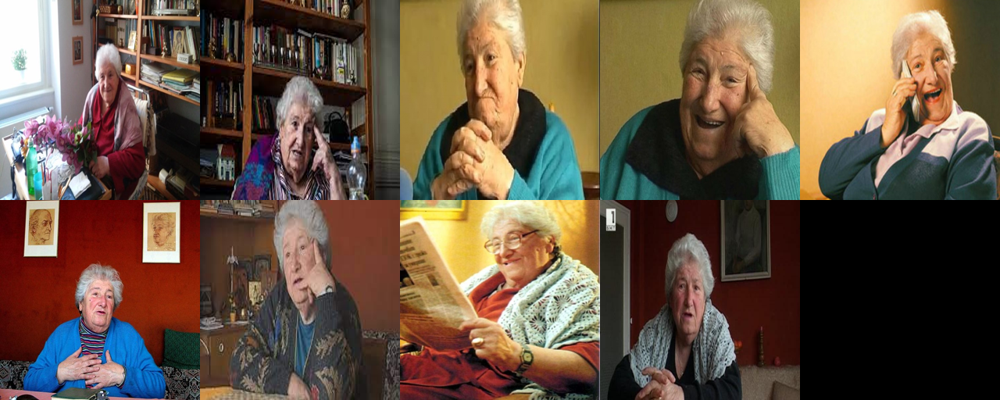

In [ ]:
imgs = [Image.open(path) for path in glob.glob(DATA_DIR_OLDLADY+'/*.jpg')]
image_grid(imgs, 2, 5, 256, 256)

In [ ]:
HF_TOKEN = userdata.get('HF_TOKEN')

In [ ]:
!autotrain dreambooth \
--model $MODEL_NAME_OLDLADY \
--project-name $PROJECT_NAME_OLDLADY \
--image-path $DATA_DIR_OLDLADY \
--prompt $PROMPT_OLDLADY \
--resolution 1024 \
--batch-size 1 \
--num-steps 500 \
--gradient-accumulation 4 \
--lr 1e-4 \
--fp16 \
--push-to-hub \
--token $HF_TOKEN \
--repo-id $REPO_ID_OLDLADY

> INFO    Namespace(version=False, revision=None, tokenizer=None, image_path='/content/drive/MyDrive/nadya_todorova_actress', class_image_path=None, prompt='actress_nadya_todorova', class_prompt=None, num_class_images=100, class_labels_conditioning=None, prior_preservation=None, prior_loss_weight=1.0, resolution=1024, center_crop=None, train_text_encoder=None, sample_batch_size=4, num_steps=500, checkpointing_steps=100000, resume_from_checkpoint=None, scale_lr=None, scheduler='constant', warmup_steps=0, num_cycles=1, lr_power=1.0, dataloader_num_workers=0, use_8bit_adam=None, adam_beta1=0.9, adam_beta2=0.999, adam_weight_decay=0.01, adam_epsilon=1e-08, max_grad_norm=1.0, allow_tf32=None, prior_generation_precision=None, local_rank=-1, xformers=None, pre_compute_text_embeddings=None, tokenizer_max_length=None, text_encoder_use_attention_mask=None, rank=4, xl=None, fp16=True, bf16=None, validation_prompt=None, num_validation_images=4, validation_epochs=50, checkpoints_total_limit=None, v

#### **2.2. Stalker**

For the role of the stalker, I will use photos of myself 🇩I made sure I selected the right photos for the occasion (it wasn't that hard, actually...).

In [ ]:
PROJECT_NAME_STALKER = "Stalker_Actor_Posleden_Strah_High_Res_2"
MODEL_NAME_STALKER = "stabilityai/stable-diffusion-xl-base-1.0"
DATA_DIR_STALKER = "/content/drive/MyDrive/stable-storyboards/posleden_strah_actor_high_res"
REPO_ID_STALKER = "windowpane/stalker-actor-LoRA-highres-2"
PROMPT_STALKER = "stalker_actor"

In [ ]:
imgs = [Image.open(path) for path in glob.glob(DATA_DIR_STALKER+'/*.JPEG')]
imgs = [img.rotate(270) for img in imgs]
image_grid(imgs, 2, 5, 512, 512)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
!autotrain dreambooth \
--model $MODEL_NAME_STALKER \
--project-name $PROJECT_NAME_STALKER \
--image-path $DATA_DIR_STALKER \
--prompt $PROMPT_STALKER \
--resolution 1024 \
--batch-size 1 \
--num-steps 500 \
--gradient-accumulation 4 \
--lr 1e-4 \
--fp16 \
--push-to-hub \
--token $HF_TOKEN \
--repo-id $REPO_ID_STALKER

> INFO    Namespace(version=False, revision=None, tokenizer=None, image_path='/content/drive/MyDrive/posleden_strah_actor_high_res', class_image_path=None, prompt='stalker_actor', class_prompt=None, num_class_images=100, class_labels_conditioning=None, prior_preservation=None, prior_loss_weight=1.0, resolution=1024, center_crop=None, train_text_encoder=None, sample_batch_size=4, num_steps=500, checkpointing_steps=100000, resume_from_checkpoint=None, scale_lr=None, scheduler='constant', warmup_steps=0, num_cycles=1, lr_power=1.0, dataloader_num_workers=0, use_8bit_adam=None, adam_beta1=0.9, adam_beta2=0.999, adam_weight_decay=0.01, adam_epsilon=1e-08, max_grad_norm=1.0, allow_tf32=None, prior_generation_precision=None, local_rank=-1, xformers=None, pre_compute_text_embeddings=None, tokenizer_max_length=None, text_encoder_use_attention_mask=None, rank=4, xl=None, fp16=True, bf16=None, validation_prompt=None, num_validation_images=4, validation_epochs=50, checkpoints_total_limit=None, val

### 3. Style
The style of this film will somewhat resemble parts of Norwegian movie **"The Innocents"** directed by Eskil Vogt.

I have absolutely no intentions to steal his work or style, and will not use them for commersial or any other purposes related to personal gain.

This is to demonstrate the capabilities of this pipeline. Moreover, these screenshots do not represent the overall visual style of the above-mentioned film.

Again, I will use the Autotrain-Advanced pipeline to combine Dreambooth fine-tuning and adaptation via LoRA.

All the LoRA models are pushed to my HuggingFace acount, where I will be downloading them from later on.

#### **3.1. Style 1**

In [ ]:
PROJECT_NAME_STYLE_1 = "Posleden_Strah_Visual_Style_1"
MODEL_NAME_STYLE_1 = "stabilityai/stable-diffusion-xl-base-1.0"
DATA_DIR_STYLE_1 = "/content/drive/MyDrive/stable-storyboards/style_1"
REPO_ID_STYLE_1 = "windowpane/final-fear-LoRA-style-1"
PROMPT_STYLE_1 = "Posleden_Strah_Visual_Style_1"

In [ ]:
imgs = [Image.open(path) for path in glob.glob(DATA_DIR_STYLE_1+'/*.png')]
image_grid(imgs, 5, 2, 512, 384)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
!autotrain dreambooth \
--model $MODEL_NAME_STYLE_1 \
--project-name $PROJECT_NAME_STYLE_1 \
--image-path $DATA_DIR_STYLE_1 \
--prompt $PROMPT_STYLE_1 \
--resolution 1024 \
--batch-size 1 \
--num-steps 500 \
--gradient-accumulation 4 \
--lr 1e-4 \
--fp16 \
--push-to-hub \
--token $HF_TOKEN \
--repo-id $REPO_ID_STYLE_1

> INFO    Namespace(version=False, revision=None, tokenizer=None, image_path='/content/drive/MyDrive/style_1', class_image_path=None, prompt='Posleden_Strah_Visual_Style_1', class_prompt=None, num_class_images=100, class_labels_conditioning=None, prior_preservation=None, prior_loss_weight=1.0, resolution=1024, center_crop=None, train_text_encoder=None, sample_batch_size=4, num_steps=500, checkpointing_steps=100000, resume_from_checkpoint=None, scale_lr=None, scheduler='constant', warmup_steps=0, num_cycles=1, lr_power=1.0, dataloader_num_workers=0, use_8bit_adam=None, adam_beta1=0.9, adam_beta2=0.999, adam_weight_decay=0.01, adam_epsilon=1e-08, max_grad_norm=1.0, allow_tf32=None, prior_generation_precision=None, local_rank=-1, xformers=None, pre_compute_text_embeddings=None, tokenizer_max_length=None, text_encoder_use_attention_mask=None, rank=4, xl=None, fp16=True, bf16=None, validation_prompt=None, num_validation_images=4, validation_epochs=50, checkpoints_total_limit=None, validatio

## Inference

### 1. Prompts

Prompts are probably the most crucial part for text-to-image generation.

I tried different prompts with varying results. In the following, I will share the ones leading to results that are most worthwhile.


#### Getting rid of useless text.

Let's start by cutting the parts of the prompts that we don't need. For example, the Sunday part of the time column doesn't really bring anything useful to the table. Therefore, we'd better get rid of it.

In [ ]:
def cut_replace_strings(string_to_cut, string_to_replace, feature):
  for i in range(len(feature)):
    feature[i] = feature[i].replace(string_to_cut, string_to_replace)
  return shotlist

In [ ]:
shotlist = cut_replace_strings("Sunday ", "", shotlist.time)

In [ ]:
assert shotlist.time[10] == "afternoon, winter"

#### Adding the character-specific prompts from the custom-trained LoRA weights.

Here, I will be replacing the words depicting the characters in the **action** column ("woman" and "man") with the specific prompts for the
models trained on the photos of the actors.

In [ ]:
action_prompts = []
for i in range(len(shotlist.action)):
  if (("woman" in shotlist.action[i]) and (" man" in shotlist.action[i])):
    action_prompt = shotlist.action[i].replace("woman", "oldlady " + PROMPT_OLDLADY).replace(" man", " "+PROMPT_STALKER)
  elif "woman" in shotlist.action[i]:
    action_prompt = shotlist.action[i].replace("woman", "oldlady " + PROMPT_OLDLADY)
  elif " man" in shotlist.action[i]:
    action_prompt = shotlist.action[i].replace(" man", " "+PROMPT_STALKER)
  else:
    action_prompt = shotlist.action[i]
  action_prompts.append(action_prompt)

In [ ]:
assert action_prompts[9] == "The oldlady actress_nadya_todorova looks around again. A car passes in the distance. The ATM is counting. A few meters behind her, a figure of a young stalker_actor, 30-years-old, appears, walking slowly in her direction. She turns and sees him."

#### Preparing the final prompts
Finally, it's time to compose the prompts based on the important information. I will put more emphasis on the **shot types** and the **camera angles**.

In [ ]:
fin_prompts = []
for i, prompt in enumerate(action_prompts):
  shot_type = "(" + shotlist.shot_type[i] + ":1.5), "
  camera_angle = ""
  if str(shotlist.camera_angle_position[i]) != 'nan':
    camera_angle = "(" + str(shotlist.camera_angle_position[i]) + ":1.5), "
  time = shotlist.time[i] + ', '
  place = shotlist.place[i]

  fin_prompt = shot_type + camera_angle + prompt + ", " + time + place
  fin_prompts.append(fin_prompt)

In [ ]:
assert fin_prompts[8] == "(Extreme close-up:1.5), The oldlady actress_nadya_todorova typing in an amount of money at the ATM., afternoon, winter, Sofia - Lyulin"

### 2. Setting up the pipeline
I will be using a variation autoencoder for the pipeline because it speeds up the loading of the SDXL model. Also, I have the feeling that it leads to improved quality of the images.

In [ ]:
vae16 = AutoencoderKL.from_pretrained(
    "madebyollin/sdxl-vae-fp16-fix",
    torch_dtype=torch.float16)

pipeline = DiffusionPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0",
    vae = vae16,
    torch_dtype = torch.float16,
    variant = "fp16",
    use_safetensors=True,
).to('cuda')

config.json:   0%|          | 0.00/631 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

model_index.json:   0%|          | 0.00/609 [00:00<?, ?B/s]

Fetching 17 files:   0%|          | 0/17 [00:00<?, ?it/s]

model.fp16.safetensors:   0%|          | 0.00/246M [00:00<?, ?B/s]

model.fp16.safetensors:   0%|          | 0.00/1.39G [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/565 [00:00<?, ?B/s]

text_encoder_2/config.json:   0%|          | 0.00/575 [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/479 [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/737 [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

tokenizer_2/special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

tokenizer_2/tokenizer_config.json:   0%|          | 0.00/725 [00:00<?, ?B/s]

tokenizer_2/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/1.68k [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/167M [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/5.14G [00:00<?, ?B/s]

tokenizer_2/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

### 3. Loading the LoRA weights and assigning Adaptor Names

Well, this part is pretty much self-explanatory:

In [ ]:
pipeline.load_lora_weights(REPO_ID_OLDLADY, weight_name="pytorch_lora_weights.safetensors",
                                   adapter_name="oldlady-actress")
pipeline.load_lora_weights(REPO_ID_STALKER, weight_name="pytorch_lora_weights.safetensors",
                                   adapter_name="stalker")
pipeline.load_lora_weights(REPO_ID_STYLE_1, weight_name="pytorch_lora_weights.safetensors",
                                   adapter_name="style-1")

pytorch_lora_weights.safetensors:   0%|          | 0.00/23.4M [00:00<?, ?B/s]

pytorch_lora_weights.safetensors:   0%|          | 0.00/23.4M [00:00<?, ?B/s]

pytorch_lora_weights.safetensors:   0%|          | 0.00/23.4M [00:00<?, ?B/s]

### 4. Executing the inference

At last, we can actually create our first storyboard! Before we get to it, we have to make sure to set the adapters with the adapter weights of our preference.

I did a total of 9 experiments, but in the following I will be focusing only on the most interesting ones. You can check the rest at ".../stable-storyboads/inference_sequences/"

In [ ]:
for i, prompt in enumerate(fin_prompts):
  if (PROMPT_OLDLADY in prompt) and (PROMPT_STALKER in prompt):
    pipeline.set_adapters(["oldlady-actress", "stalker", "style-1"], adapter_weights=[1.0, 1.0, 0.6])
  elif PROMPT_OLDLADY in prompt:
    pipeline.set_adapters(["oldlady-actress", "style-1"], adapter_weights=[1.0, 0.6])
  elif PROMPT_STALKER in prompt:
    pipeline.set_adapters(["stalker", "style-1"], adapter_weights=[1.0, 0.6])
  else:
    pipeline.set_adapters("stalker")

  image = pipeline(prompt=prompt, num_inference_steps=70, width=1360, height=768, cross_attention_kwargs={"scale": 1},
                   generator=torch.manual_seed(0), guidance_scale=7, num_images_per_prompt = 1)

  image.images[0].save("/content/drive/MyDrive/inference_sequences/seq_2/shot"+str(i+1)+".jpg")

In [ ]:
seq_2 = [Image.open(path) for path in glob.glob('/content/drive/MyDrive/stable-storyboards/inference_sequences/seq_2/*.jpg')]
image_grid(seq_2, 10, 3, 1360, 768)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
for i, camera_position in enumerate(shotlist.camera_angle_position):
  camera_position = str(camera_position)
  if "front" in camera_position:
    camera_position = "straight on"
  elif "behind" in camera_position:
    camera_position = "from behind"
  elif "point of view" in camera_position:
    camera_position = "point-of-view"
  else:
    camera_position = camera_position
  shotlist.camera_angle_position[i] = camera_position

In [ ]:
assert shotlist.camera_angle_position[1] == "straight on"

In [ ]:
shotlist = cut_replace_strings(" - Lyulin", "", shotlist.place)

In [ ]:
assert shotlist.place[4] == "Sofia"

#### Putting Style info to the Prompts

I decided to try out how things would look like if I added the Style_1 prompt to the final prompts. It turned out that there is not such a big difference...

In [ ]:
fin_prompts_with_style = []
for i, action in enumerate(action_prompts):
  shot_type = "(" + shotlist.shot_type[i] + ":1.5), "
  camera_angle = ""
  if str(shotlist.camera_angle_position[i]) != 'nan':
    camera_angle = "(" + str(shotlist.camera_angle_position[i]) + ":1.5), "
  time = shotlist.time[i] + ', '
  place = shotlist.place[i]

  fin_prompt = shot_type + action +  ", in the style of " + PROMPT_STYLE_1 + ", " + time + place
  fin_prompts_with_style.append(fin_prompt)
print(fin_prompts_with_style[0])

(Cowboy shot:1.5), A actress_nadya_todorova walks on the sidewalk of a medium-sized street., in the style of Posleden_Strah_Visual_Style_1, afternoon, winter, Sofia


In [ ]:
assert fin_prompts_with_style[0] == '(Cowboy shot:1.5), A actress_nadya_todorova walks on the sidewalk of a medium-sized street., in the style of Posleden_Strah_Visual_Style_1, afternoon, winter, Sofia'

Now, let's test how it works:

In [ ]:
for i, prompt in enumerate(fin_prompts):
  if (PROMPT_OLDLADY in prompt) and (PROMPT_STALKER in prompt):
    pipeline.set_adapters(["oldlady-actress", "stalker", "style-1"], adapter_weights=[1.0, 1.0, 0.5])
  elif PROMPT_OLDLADY in prompt:
    pipeline.set_adapters(["oldlady-actress", "style-1"], adapter_weights=[1.0, 0.5])
  elif PROMPT_STALKER in prompt:
    pipeline.set_adapters(["stalker", "style-1"], adapter_weights=[1.0, 0.5])
  else:
    pipeline.set_adapters("style-1")

  image = pipeline(prompt=prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(10), guidance_scale=9, num_images_per_prompt = 1)

  image.images[0].save("/content/drive/MyDrive/inference_sequences/seq_3/shot"+str(i+1)+".jpg")
  image.images[0]

In [ ]:
seq_3 = [Image.open(path) for path in glob.glob('/content/drive/MyDrive/stable-storyboards/inference_sequences/seq_3/*.jpg')]
image_grid(seq_3, 10, 3, 1360, 768)

In [ ]:
for i, prompt in enumerate(fin_prompts):
  if (PROMPT_OLDLADY in prompt) and (PROMPT_STALKER in prompt):
    pipeline.set_adapters(["oldlady-actress", "stalker", "style-1"], adapter_weights=[1.0, 1.0, 0.5])
  elif PROMPT_OLDLADY in prompt:
    pipeline.set_adapters(["oldlady-actress", "style-1"], adapter_weights=[1.0, 0.5])
  elif PROMPT_STALKER in prompt:
    pipeline.set_adapters(["stalker", "style-1"], adapter_weights=[1.0, 0.5])
  else:
    pipeline.set_adapters("style-1")

  image = pipeline(prompt=prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(10), guidance_scale=9, num_images_per_prompt = 1)

  image.images[0].save("/content/drive/MyDrive/inference_sequences/seq_5/shot"+str(i+1)+".jpg")
  image.images[0]

In [ ]:
seq_5 = [Image.open(path) for path in glob.glob('/content/drive/MyDrive/stable-storyboards/inference_sequences/seq_5/*.jpg')]
image_grid(seq_5, 10, 3, 1360, 768)

#### Improving the final prompts with camera angle.

Here, I tried to improve the final prompts with the updated values of the camera angles. I think, the positive results in terms of the camera angles are quite hard to miss.

In [ ]:
negative_prompt = "low-quality, sunny, summer, spring, sun, happy people"

fin_prompts = []
for i, action in enumerate(action_prompts):
  shot_type = "(" + shotlist.shot_type[i] + ":1.5), "
  camera_angle = ""
  if str(shotlist.camera_angle_position[i]) != 'nan':
    camera_angle = "(" + str(shotlist.camera_angle_position[i]) + ":1.5), "
  time = shotlist.time[i] + ', '
  place = shotlist.place[i]

  fin_prompt = shot_type + camera_angle + action + ", " + time + place
  fin_prompts.append(fin_prompt)

In [ ]:
assert fin_prompts[3] == '(Medium full shot:1.5), (from behind:1.5), The actress_nadya_todorova passes across the meadow between two tall concrete living blocks., afternoon, winter, Sofia'

In [ ]:
for i, prompt in enumerate(fin_prompts):
  if (PROMPT_OLDLADY in prompt) and (PROMPT_STALKER in prompt):
    pipeline.set_adapters(["oldlady-actress", "stalker", "style-1"], adapter_weights=[1.0, 1.0, 0.5])
  elif PROMPT_OLDLADY in prompt:
    pipeline.set_adapters(["oldlady-actress", "style-1"], adapter_weights=[1.0, 0.5])
  elif PROMPT_STALKER in prompt:
    pipeline.set_adapters(["stalker", "style-1"], adapter_weights=[1.0, 0.5])
  else:
    pipeline.set_adapters("style-1")

  image = pipeline(prompt=prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(10), guidance_scale=9, num_images_per_prompt = 1)

  image.images[0].save("/content/drive/MyDrive/inference_sequences/seq_8/shot"+str(i+1)+".jpg")
  image.images[0]

In [ ]:
seq_8 = [Image.open(path) for path in glob.glob('/content/drive/MyDrive/stable-storyboards/inference_sequences/seq_8/*.jpg')]
image_grid(seq_8, 10, 3, 1360, 768)

In [ ]:
seq_2 = [Image.open(path) for path in glob.glob('/content/drive/MyDrive/stable-storyboards/inference_sequences/seq_2/*.jpg')]
seq_3 = [Image.open(path) for path in glob.glob('/content/drive/MyDrive/stable-storyboards/inference_sequences/seq_3/*.jpg')]
seq_5 = [Image.open(path) for path in glob.glob('/content/drive/MyDrive/stable-storyboards/inference_sequences/seq_5/*.jpg')]
seq_8 = [Image.open(path) for path in glob.glob('/content/drive/MyDrive/stable-storyboards/inference_sequences/seq_8/*.jpg')]

In [ ]:
compare_seqs = []
for i in range(len(seq_2)):
  compare_seqs.append(seq_2[i])
  compare_seqs.append(seq_3[i])
  compare_seqs.append(seq_5[i])
  compare_seqs.append(seq_8[i])

In [ ]:
grid = image_grid(compare_seqs, 30, 4, 384, 256)

In [ ]:
grid

Output hidden; open in https://colab.research.google.com to view.

## Boosting Control of Shot Types and Camera Angles with ControlNet

Luckily, we can control the position of objects in the frame, as well as their pose and the frame's depth via a tool called ControlNet. The good people at HuggingFace have been adding numerous pipelines for implementing different aspects of ControlNet.

With ControlNet, we will not be needing the shot types and the camera angles to be in the prompt, because we can control these aspects more thoroughly by adding images regarding:
- shot type: the position of an object in the frame can be fixed **ControlNet Canny**;
- camera angle: this can be roughly controlled by bringing more control over the pose or the body stature of the object via **ControlNet Openpose**.



In [ ]:
# remove shot_type, camera_angle (unnecessary for the controlnets, will be added only for shots without any characters):
fin_prompts = []
for i, prompt in enumerate(action_prompts):
  #shot_type = "(" + shotlist.shot_type[i] + ":1.5), "
  #camera_angle = ""
  #if str(shotlist.camera_angle_position[i]) != 'nan':
    #camera_angle = "(" + str(shotlist.camera_angle_position[i]) + ":1.5), "
  time = shotlist.time[i] + ', '
  place = shotlist.place[i]

  fin_prompt = prompt + ", " + time + place
  fin_prompts.append(fin_prompt)

### ControlNet Experiments

In [ ]:
from diffusers import StableDiffusionXLControlNetPipeline, ControlNetModel, AutoencoderKL
from diffusers.utils import load_image
import torch

from PIL import Image

prompt = 'Oldlady actress_nadya_todorova walks on the sidewalk of a medium-sized street., afternoon, winter, Sofia - Lyulin'
negative_prompt = "low quality, bad quality, sketches"

#### Loading Image Templates
I will be useing [posemy.art](https://posemy.art/) to create the image "skeletons" that would be used for the shots in the shotlist.

This product allows users to create different kinds of objects specifying their position in the frame, their pose and also the visual depth. All of this is free of charge.

There are many similar tools online, but this one seemed more intuitive to me.

This is very handy for our case. Actually, it is possible to create all types shots and camera angles and write a Python function associating each shot type/ camera angle instruction with the specific image template.

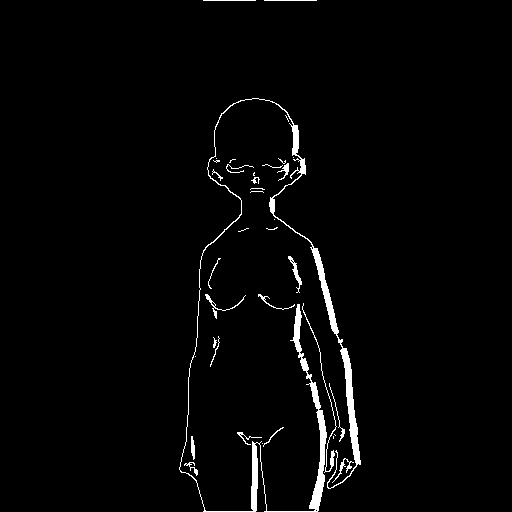

In [ ]:
# download an image
controlnet_image = load_image(
    '/content/drive/MyDrive/stable-storyboards/controlnet_images/shot_1/shot1-canny.png'
)
controlnet_image

This particular image format is more efficiently used with ControlNet Canny.

#### Loading the Canny and OpenPose Models


In [ ]:
# initialize the models

controlnet_canny = ControlNetModel.from_pretrained(
    "diffusers/controlnet-canny-sdxl-1.0", torch_dtype=torch.float16
)

controlnet_openpose = ControlNetModel.from_pretrained(
    "thibaud/controlnet-openpose-sdxl-1.0", torch_dtype=torch.float16
)

config.json:   0%|          | 0.00/1.31k [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/5.00G [00:00<?, ?B/s]

config.json:   0%|          | 0.00/1.24k [00:00<?, ?B/s]

diffusion_pytorch_model.bin:   0%|          | 0.00/5.00G [00:00<?, ?B/s]

#### Experiments with Canny

In [ ]:
vae = AutoencoderKL.from_pretrained("madebyollin/sdxl-vae-fp16-fix", torch_dtype=torch.float16)
pipeline = StableDiffusionXLControlNetPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0", controlnet=controlnet_canny, vae=vae, torch_dtype=torch.float16
).to('cuda')
#pipe.enable_model_cpu_offload()

In [ ]:
# load lora weights:

pipeline.load_lora_weights(REPO_ID_OLDLADY, weight_name="pytorch_lora_weights.safetensors",
                                   adapter_name="oldlady-actress")
pipeline.load_lora_weights(REPO_ID_STALKER, weight_name="pytorch_lora_weights.safetensors",
                                   adapter_name="stalker")
pipeline.load_lora_weights(REPO_ID_STYLE_1, weight_name="pytorch_lora_weights.safetensors",
                                   adapter_name="style-1")

In [ ]:
pipeline.set_adapters(["oldlady-actress", "style-1"], adapter_weights=[1.1, 0.5])
controlnet_conditioning_scale=0.6

image = pipeline(
    prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=controlnet_image,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=7, num_images_per_prompt = 1
)

  0%|          | 0/70 [00:00<?, ?it/s]

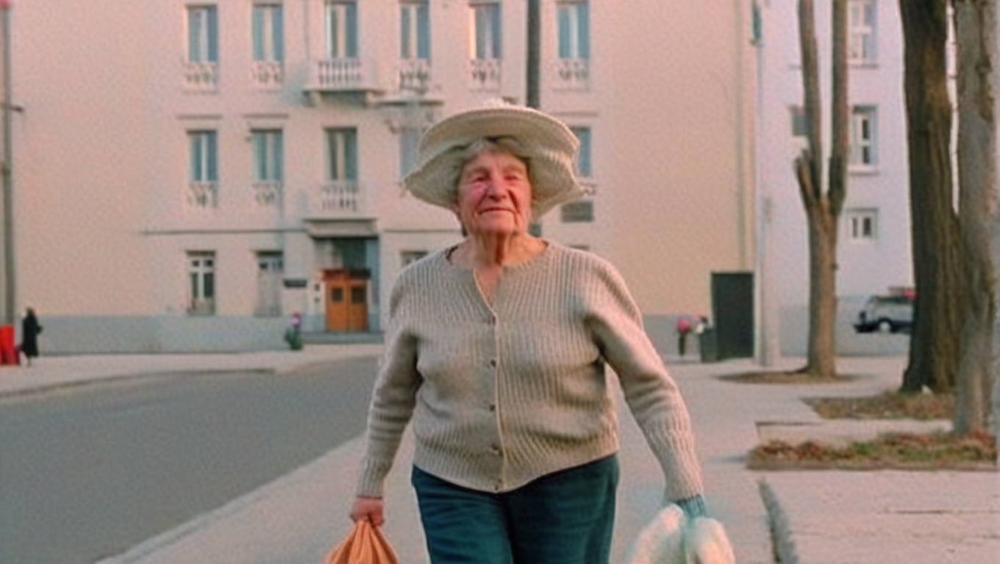

In [ ]:
image.images[0]

In [ ]:
pipeline.set_adapters(["oldlady-actress", "style-1"], adapter_weights=[1.1, 0.7])
controlnet_conditioning_scale=0.5

image = pipeline(
    prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=controlnet_image,
                   negative_prompt=negative_prompt, num_inference_steps=90, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=7, num_images_per_prompt = 1
)

  0%|          | 0/90 [00:00<?, ?it/s]

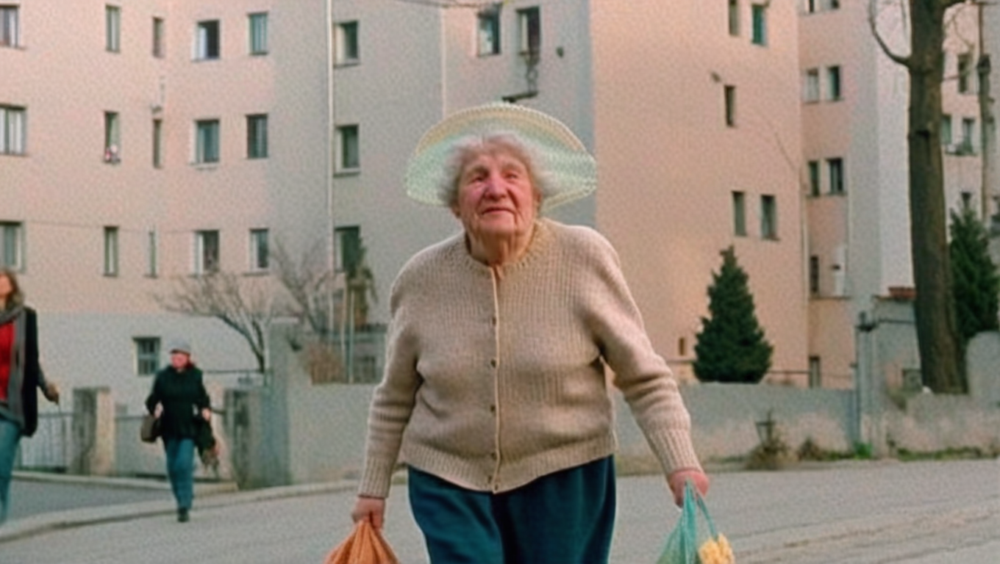

In [ ]:
image.images[0]

#### Experiments with OpenPose

We need to load an image in a specific format. This is easy to achieve by using the Openpose Detector for ControlNet.

In [ ]:
from controlnet_aux import OpenposeDetector

openpose = OpenposeDetector.from_pretrained("lllyasviel/ControlNet")

openpose_image = load_image(
    '/content/drive/MyDrive/stable-storyboards/controlnet_images/shot_1/shot1-image.png'
)
openpose_image = openpose(openpose_image)
openpose_image

Then, we have to load a different SDXL pipeline, specifying the actual ControlNet type that we are going to use - in this case, OpenPose.

In [ ]:
vae = AutoencoderKL.from_pretrained("madebyollin/sdxl-vae-fp16-fix", torch_dtype=torch.float16)
pipeline = StableDiffusionXLControlNetPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0", controlnet=controlnet_openpose, vae=vae, torch_dtype=torch.float16
).to('cuda')

config.json:   0%|          | 0.00/631 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

model_index.json:   0%|          | 0.00/609 [00:00<?, ?B/s]

Fetching 17 files:   0%|          | 0/17 [00:00<?, ?it/s]

model.safetensors:   0%|          | 0.00/2.78G [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/565 [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

text_encoder_2/config.json:   0%|          | 0.00/575 [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/737 [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/479 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

tokenizer_2/special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

tokenizer_2/tokenizer_config.json:   0%|          | 0.00/725 [00:00<?, ?B/s]

tokenizer_2/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/10.3G [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/1.68k [00:00<?, ?B/s]

tokenizer_2/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [ ]:
pipeline.load_lora_weights(REPO_ID_OLDLADY, weight_name="pytorch_lora_weights.safetensors",
                                   adapter_name="oldlady-actress")
pipeline.load_lora_weights(REPO_ID_STALKER, weight_name="pytorch_lora_weights.safetensors",
                                   adapter_name="stalker")
pipeline.load_lora_weights(REPO_ID_STYLE_1, weight_name="pytorch_lora_weights.safetensors",
                                   adapter_name="style-1")

pytorch_lora_weights.safetensors:   0%|          | 0.00/23.4M [00:00<?, ?B/s]

pytorch_lora_weights.safetensors:   0%|          | 0.00/23.4M [00:00<?, ?B/s]

pytorch_lora_weights.safetensors:   0%|          | 0.00/23.4M [00:00<?, ?B/s]

In [ ]:
pipeline.set_adapters(["oldlady-actress", "style-1"], adapter_weights=[1.1, 0.6])
#images = [controlnet_image, openpose_image]
controlnet_conditioning_scale=0.6

image = pipeline(
    prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=openpose_image,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=7, num_images_per_prompt = 1
)

  0%|          | 0/70 [00:00<?, ?it/s]

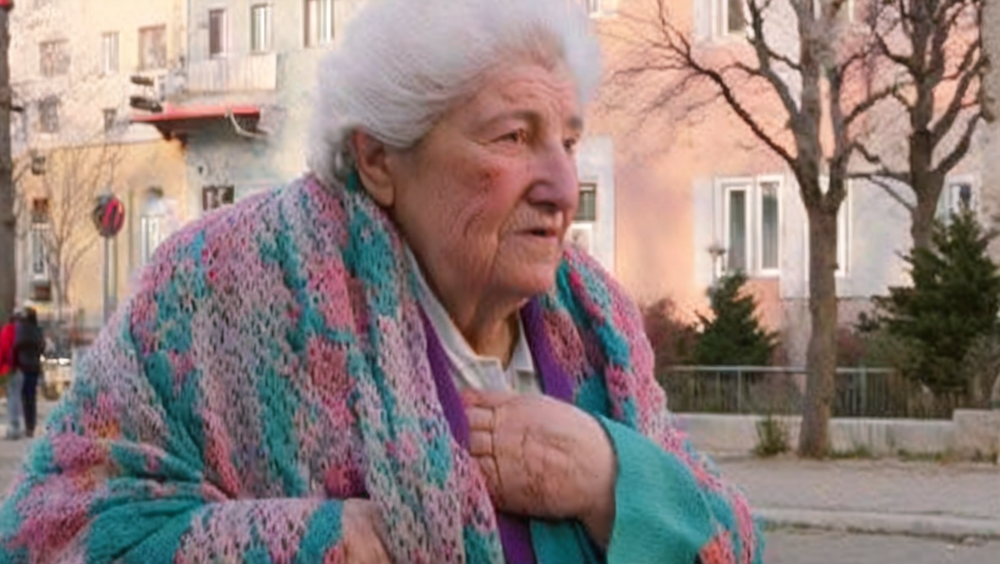

In [ ]:
image.images[0]

A we can see, OpenPose does lets us have a relatively good control on the pose, but does not let us control for the position of the main object in the frame (or, in more simple terms, the shot type). So... why not try to combine them?

### Combined ControlNet - Canny and OpenPose

In [ ]:
vae = AutoencoderKL.from_pretrained("madebyollin/sdxl-vae-fp16-fix", torch_dtype=torch.float16)

config.json:   0%|          | 0.00/631 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

In [ ]:
controlnet_combined = [controlnet_canny, controlnet_openpose]
pipeline = StableDiffusionXLControlNetPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0", controlnet=controlnet_combined, vae=vae, torch_dtype=torch.float16
).to('cuda')

model_index.json:   0%|          | 0.00/609 [00:00<?, ?B/s]

Fetching 17 files:   0%|          | 0/17 [00:00<?, ?it/s]

model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

text_encoder_2/config.json:   0%|          | 0.00/575 [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/479 [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/565 [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/737 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/2.78G [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

tokenizer_2/special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

tokenizer_2/tokenizer_config.json:   0%|          | 0.00/725 [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/1.68k [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/10.3G [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

tokenizer_2/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [ ]:
pipeline.load_lora_weights(REPO_ID_OLDLADY, weight_name="pytorch_lora_weights.safetensors",
                                   adapter_name="oldlady-actress")
pipeline.load_lora_weights(REPO_ID_STALKER, weight_name="pytorch_lora_weights.safetensors",
                                   adapter_name="stalker")
pipeline.load_lora_weights(REPO_ID_STYLE_1, weight_name="pytorch_lora_weights.safetensors",
                                   adapter_name="style-1")

pytorch_lora_weights.safetensors:   0%|          | 0.00/23.4M [00:00<?, ?B/s]

pytorch_lora_weights.safetensors:   0%|          | 0.00/23.4M [00:00<?, ?B/s]

pytorch_lora_weights.safetensors:   0%|          | 0.00/23.4M [00:00<?, ?B/s]

In [ ]:
pipeline.set_adapters(["oldlady-actress", "style-1"], adapter_weights=[1.1, 0.6])
images = [controlnet_image, openpose_image]
controlnet_conditioning_scale=[0.4, 0.8]

image = pipeline(
    prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=7, num_images_per_prompt = 1
)

  0%|          | 0/70 [00:00<?, ?it/s]

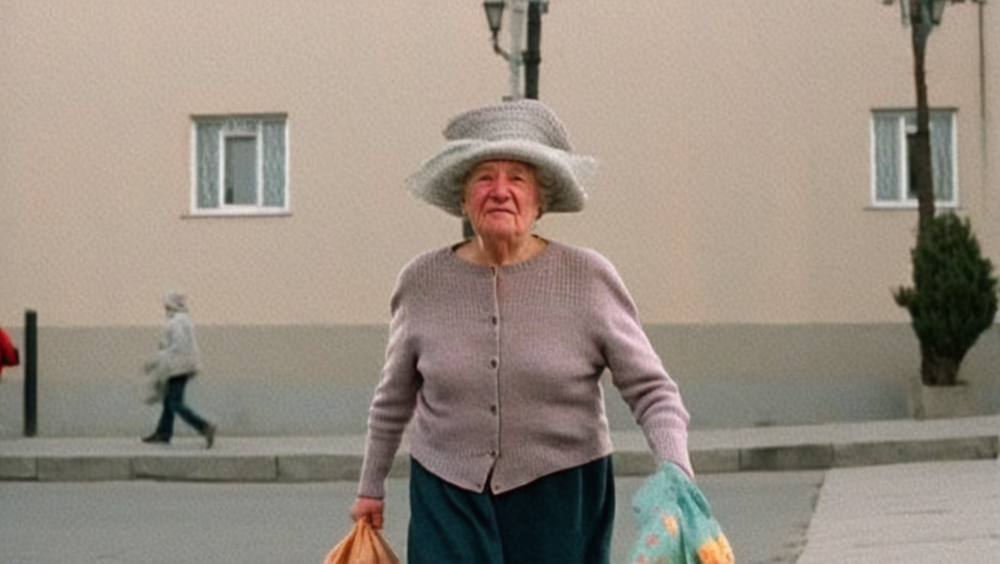

In [ ]:
image.images[0]

In [ ]:
pipeline.set_adapters(["oldlady-actress", "style-1"], adapter_weights=[1.1, 0.6])
images = [controlnet_image, openpose_image]
controlnet_conditioning_scale=[0.3, 0.8]

image = pipeline(
    prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=7, num_images_per_prompt = 1
)

  0%|          | 0/70 [00:00<?, ?it/s]

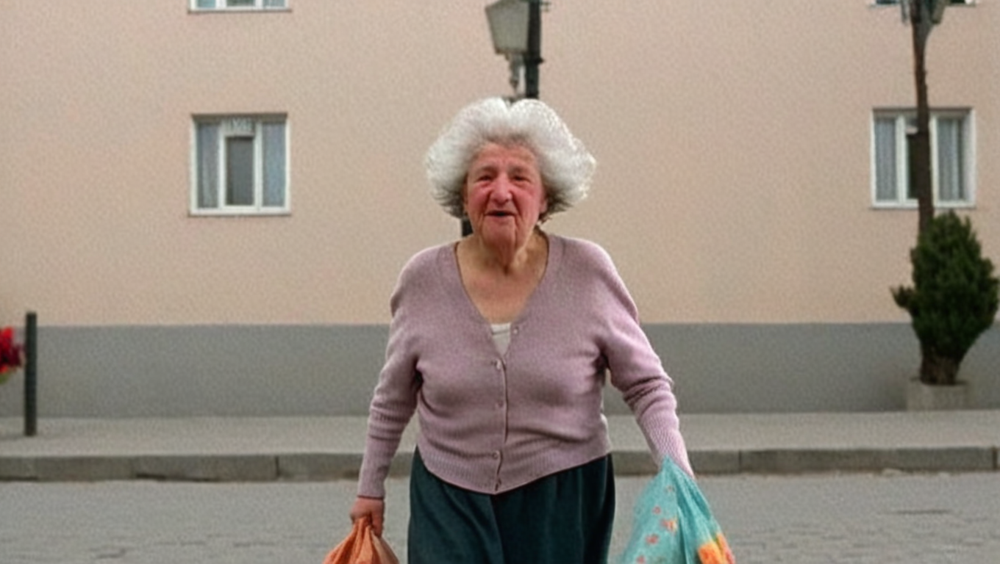

In [ ]:
image.images[0]

In [ ]:
pipeline.set_adapters(["oldlady-actress", "style-1"], adapter_weights=[1.1, 0.6])
images = [controlnet_image, openpose_image]
controlnet_conditioning_scale=[0.2, 0.8]

image = pipeline(
    prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=7, num_images_per_prompt = 1
)

  0%|          | 0/70 [00:00<?, ?it/s]

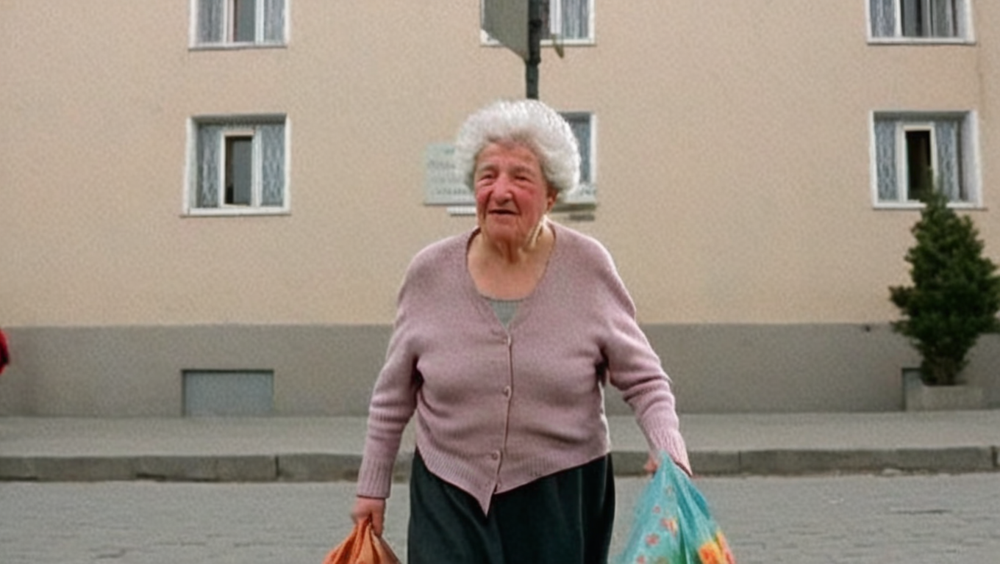

In [ ]:
image.images[0]

In [ ]:
pipeline.set_adapters(["oldlady-actress", "style-1"], adapter_weights=[1.1, 0.6])
images = [controlnet_image, openpose_image]
controlnet_conditioning_scale=[0.2, 0.9]

image = pipeline(
    prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=7, num_images_per_prompt = 1
)

  0%|          | 0/70 [00:00<?, ?it/s]

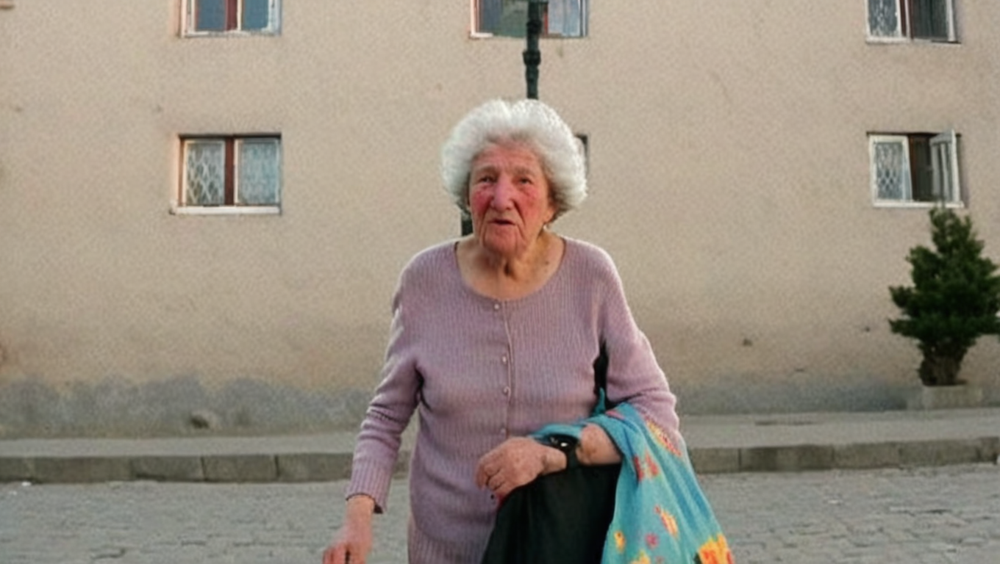

In [ ]:
image.images[0]

In [ ]:
pipeline.set_adapters(["oldlady-actress", "style-1"], adapter_weights=[1.1, 0.5])
images = [controlnet_image, openpose_image]
controlnet_conditioning_scale=[0.2, 1.0]

image = pipeline(
    prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=7, num_images_per_prompt = 1
)

  0%|          | 0/70 [00:00<?, ?it/s]

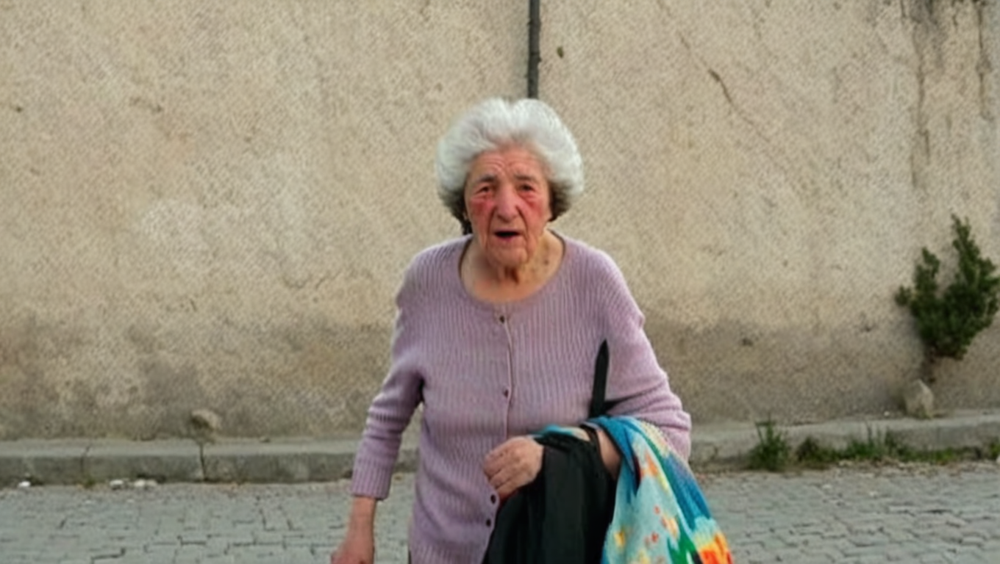

In [ ]:
image.images[0]

In [ ]:
pipeline.set_adapters(["oldlady-actress", "style-1"], adapter_weights=[1.1, 0.7])
images = [controlnet_image, openpose_image]
controlnet_conditioning_scale=[0.2, 0.8]

image = pipeline(
    prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=9, num_images_per_prompt = 1
)

  0%|          | 0/70 [00:00<?, ?it/s]

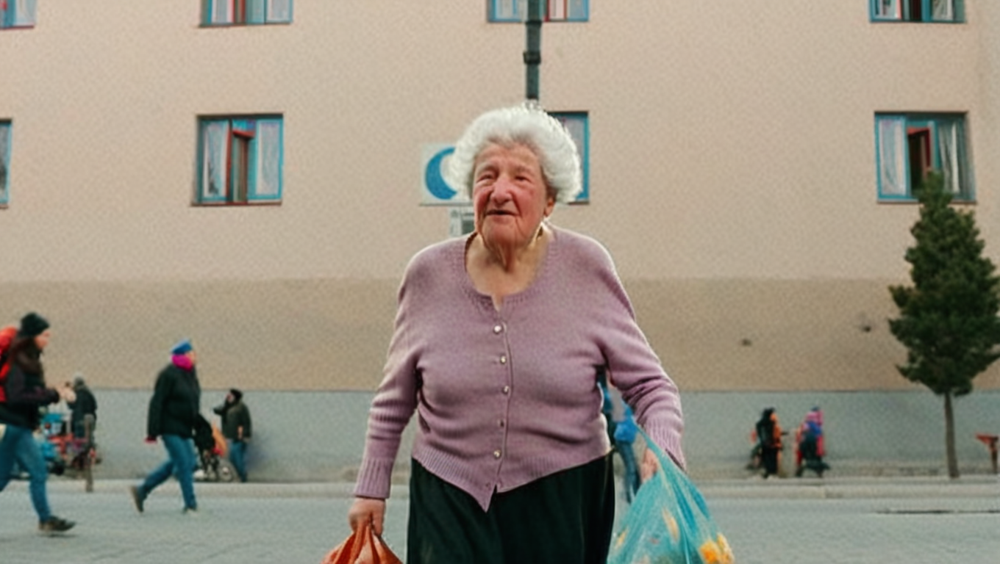

In [ ]:
image.images[0]

In [ ]:
pipeline.set_adapters(["oldlady-actress", "style-1"], adapter_weights=[1.1, 0.7])
images = [controlnet_image, openpose_image]
controlnet_conditioning_scale=[0.2, 0.9]

image = pipeline(
    prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=9, num_images_per_prompt = 1
)

  0%|          | 0/70 [00:00<?, ?it/s]

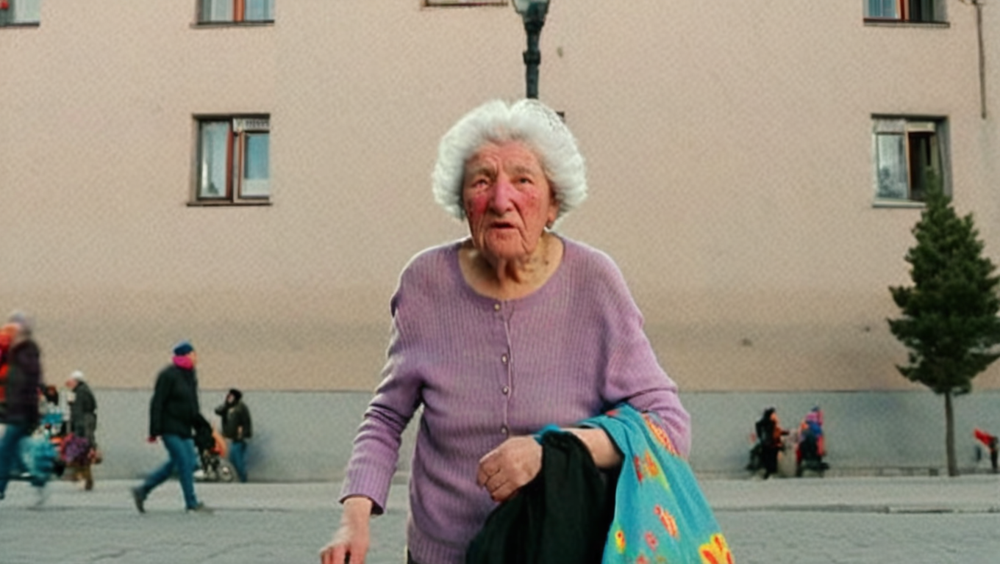

In [ ]:
image.images[0]

In [ ]:
pipeline.set_adapters(["oldlady-actress", "style-1"], adapter_weights=[1.0, 0.7])
images = [controlnet_image, openpose_image]
controlnet_conditioning_scale=[0.2, 0.8]

image = pipeline(
    prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=9, num_images_per_prompt = 1
)

  0%|          | 0/70 [00:00<?, ?it/s]

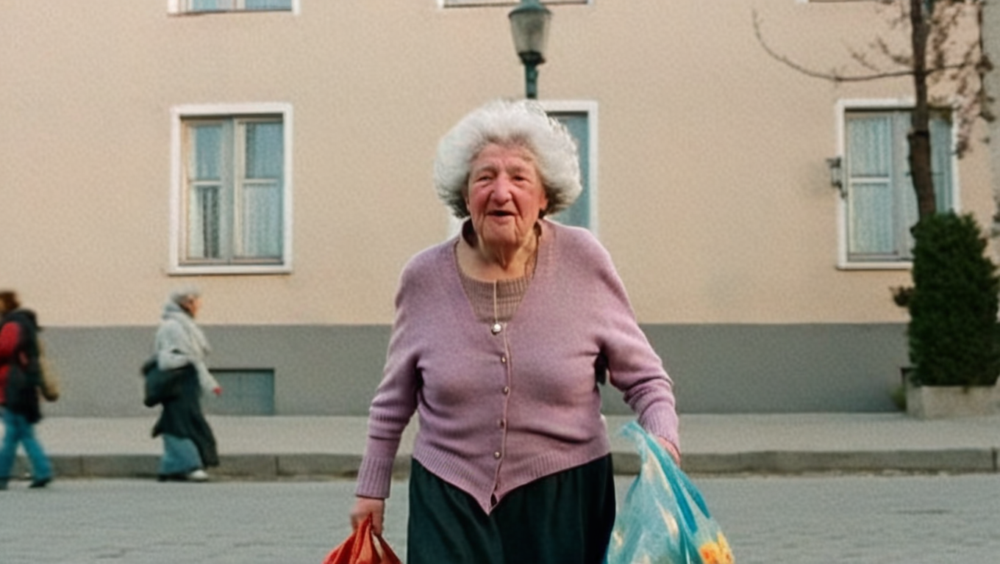

In [ ]:
image.images[0]

In [ ]:
pipeline.set_adapters(["oldlady-actress", "style-1"], adapter_weights=[1.2, 0.7])
images = [controlnet_image, openpose_image]
controlnet_conditioning_scale=[0.2, 0.8]

image = pipeline(
    prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=9, num_images_per_prompt = 1
)

  0%|          | 0/70 [00:00<?, ?it/s]

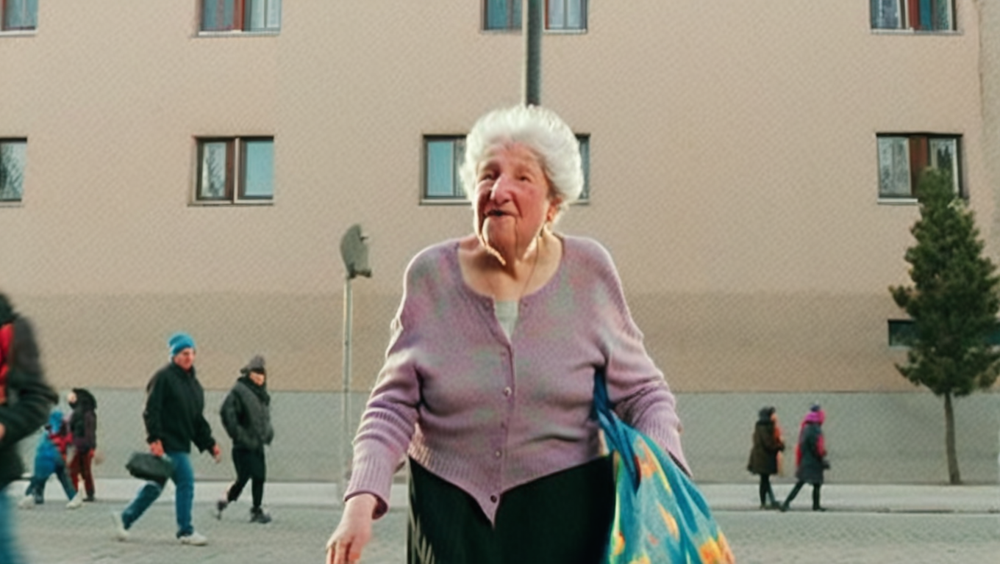

In [ ]:
image.images[0]

## Shotlist-to-Storyboard Generation with ControlNet

After all these experiments, we are ready for mass production of images based on the shotlist. For a lack of time and to save some computing power, we will generate the first 12 shots. However, the same principles hold and can be implemented for generating the remaining 18 shots.


### Image Templates

Here are the image templates we are going to use for the storyboard making.

Please, note that **shot_6** and **shot_11** do not contain any of the characters in the frame at all. That's why the images below are 10 instead of 12.

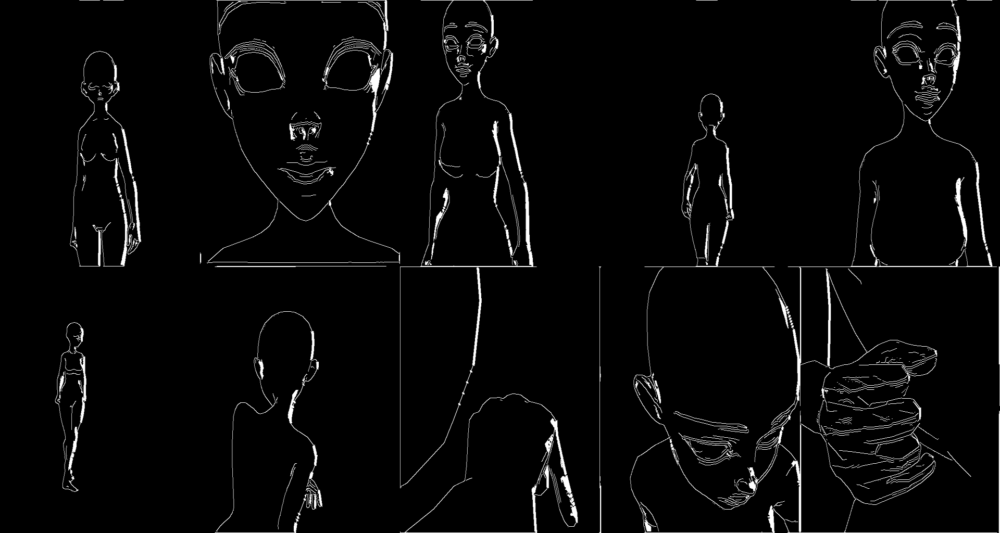

In [ ]:
shots_canny_dir = '/content/drive/MyDrive/stable-storyboards/controlnet_images/shots_canny'
imgs = [Image.open(path) for path in glob.glob(shots_canny_dir+'/*.png')]
image_grid(imgs, 2, 5)

### Shotlist-to-Storyboard Generation with Combined ControlNet Model


In [ ]:
from diffusers import StableDiffusionXLControlNetPipeline, ControlNetModel, AutoencoderKL
from diffusers.utils import load_image
import torch

from PIL import Image

from controlnet_aux import OpenposeDetector

openpose = OpenposeDetector.from_pretrained("lllyasviel/ControlNet")

# prompt = 'Oldlady actress_nadya_todorova walks on the sidewalk of a medium-sized street., afternoon, winter, Sofia - Lyulin'
negative_prompt = "low quality, bad quality, sketches"

/usr/local/lib/python3.10/dist-packages/controlnet_aux/mediapipe_face/mediapipe_face_common.py:7: UserWarning: The module 'mediapipe' is not installed. The package will have limited functionality. Please install it using the command: pip install 'mediapipe'
  warnings.warn(


body_pose_model.pth:   0%|          | 0.00/209M [00:00<?, ?B/s]

hand_pose_model.pth:   0%|          | 0.00/147M [00:00<?, ?B/s]

facenet.pth:   0%|          | 0.00/154M [00:00<?, ?B/s]

In [ ]:
# initialize the models and pipeline

controlnet_canny = ControlNetModel.from_pretrained(
    "diffusers/controlnet-canny-sdxl-1.0", torch_dtype=torch.float16
)

controlnet_openpose = ControlNetModel.from_pretrained(
    "thibaud/controlnet-openpose-sdxl-1.0", torch_dtype=torch.float16
)

config.json:   0%|          | 0.00/1.31k [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/5.00G [00:00<?, ?B/s]

config.json:   0%|          | 0.00/1.24k [00:00<?, ?B/s]

diffusion_pytorch_model.bin:   0%|          | 0.00/5.00G [00:00<?, ?B/s]

In [ ]:
vae = AutoencoderKL.from_pretrained("madebyollin/sdxl-vae-fp16-fix", torch_dtype=torch.float16)

config.json:   0%|          | 0.00/631 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

In [ ]:
controlnet_combined = [controlnet_canny, controlnet_openpose]
pipeline = StableDiffusionXLControlNetPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0", controlnet=controlnet_combined, vae=vae, torch_dtype=torch.float16
)
pipeline.enable_model_cpu_offload()

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [ ]:
pipeline_wo_controlnet = DiffusionPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0",
    torch_dtype = torch.float16,
    variant = "fp16",
    use_safetensors=True,
)
pipeline_wo_controlnet.enable_model_cpu_offload()

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [ ]:
pipeline.load_lora_weights(REPO_ID_OLDLADY, weight_name="pytorch_lora_weights.safetensors",
                                   adapter_name="oldlady-actress")
pipeline.load_lora_weights(REPO_ID_STALKER, weight_name="pytorch_lora_weights.safetensors",
                                   adapter_name="stalker")
pipeline.load_lora_weights(REPO_ID_STYLE_1, weight_name="pytorch_lora_weights.safetensors",
                                   adapter_name="style-1")
pipeline_wo_controlnet.load_lora_weights(REPO_ID_STYLE_1, weight_name="pytorch_lora_weights.safetensors",
                                   adapter_name="style-1")

In [ ]:
controlnet_conditioning_scale=[0.4, 0.8]
for i in range(0, 11):
  prompt = fin_prompts[i]
  image_link = '/content/drive/MyDrive/stable-storyboards/controlnet_images/shot_' + str(i+1) + '/shot' + str(i+1) + '-canny.png'
  save_image_link = "/content/drive/MyDrive/stable-storyboards/inference_sequences/seq_10/shot"+str(i+1)+".jpg"
  if (PROMPT_OLDLADY in prompt) and (PROMPT_STALKER in prompt):
    controlnet_image = load_image(image_link)
    openpose_image = openpose(controlnet_image)
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["oldlady-actress", "stalker", "style-1"], adapter_weights=[1.2, 1.2, 0.7])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=9, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  elif PROMPT_OLDLADY in prompt:
    controlnet_image = load_image(image_link)
    openpose_image = openpose(load_image(image_link))
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["oldlady-actress", "style-1"], adapter_weights=[1.2, 0.7])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=9, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  elif PROMPT_STALKER in prompt:
    controlnet_image = load_image(image_link)
    openpose_image = openpose(load_image(image_link))
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["stalker", "style-1"], adapter_weights=[1.2, 0.7])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=9, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  else:
    pipeline_wo_controlnet.set_adapters("style-1")
    image = pipeline_wo_controlnet(prompt=prompt,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=9, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)

  0%|          | 0/70 [00:00<?, ?it/s]

A oldlady actress_nadya_todorova walks on the sidewalk of a medium-sized street., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova walks on the sidewalk of a medium-sized street. She looks around nervously. Goes into an underpass, we can see her walking in it., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova is coming out of the subway and goes left (toward the viewer), until it is out of frame., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova passes across the meadow between two tall concrete living blocks., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova passes across the meadow between two tall concrete living blocks. She looks around sporadically., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The meadow and the blocks., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova approaches a bank building with an ATM in front. She heads to the ATM., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova takes out her card and puts it in the ATM. She looks around, it seems that there is no one there., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova typing in an amount of money at the ATM., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova looks around again. A car passes in the distance. The ATM is counting. A few meters behind her, a figure of a young stalker_actor, 30-years-old, appears, walking slowly in her direction. She turns and sees him., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The machine beeps, finally "spits out" the banknotes - four BGN 50 each., afternoon, winter, Sofia - Lyulin


In [ ]:
save_image_dir = '/content/drive/MyDrive/stable-storyboards/inference_sequences/seq_10'
imgs = [Image.open(path) for path in glob.glob(save_image_dir+'/*.jpg')]
image_grid(imgs, 4, 3, 1360, 768)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
pipeline.scheduler.compatibles

[diffusers.schedulers.scheduling_lms_discrete.LMSDiscreteScheduler,
 diffusers.schedulers.scheduling_dpmsolver_singlestep.DPMSolverSinglestepScheduler,
 diffusers.schedulers.scheduling_deis_multistep.DEISMultistepScheduler,
 diffusers.utils.dummy_torch_and_torchsde_objects.DPMSolverSDEScheduler,
 diffusers.schedulers.scheduling_heun_discrete.HeunDiscreteScheduler,
 diffusers.schedulers.scheduling_ddpm.DDPMScheduler,
 diffusers.schedulers.scheduling_pndm.PNDMScheduler,
 diffusers.schedulers.scheduling_k_dpm_2_ancestral_discrete.KDPM2AncestralDiscreteScheduler,
 diffusers.schedulers.scheduling_euler_discrete.EulerDiscreteScheduler,
 diffusers.schedulers.scheduling_euler_ancestral_discrete.EulerAncestralDiscreteScheduler,
 diffusers.schedulers.scheduling_dpmsolver_multistep.DPMSolverMultistepScheduler,
 diffusers.schedulers.scheduling_k_dpm_2_discrete.KDPM2DiscreteScheduler,
 diffusers.schedulers.scheduling_unipc_multistep.UniPCMultistepScheduler,
 diffusers.schedulers.scheduling_ddim.DDI

In [ ]:
from diffusers import LMSDiscreteScheduler

pipeline.scheduler = LMSDiscreteScheduler.from_config(pipeline.scheduler.config)

In [ ]:
controlnet_conditioning_scale=[0.5, 0.5]
for i in range(0, 11):
  prompt = fin_prompts[i]
  image_link = '/content/drive/MyDrive/stable-storyboards/controlnet_images/shot_' + str(i+1) + '/shot' + str(i+1) + '-canny.png'
  save_image_link = "/content/drive/MyDrive/stable-storyboards/inference_sequences/seq_11_lmsscheduler/shot"+str(i+1)+".jpg"
  if (PROMPT_OLDLADY in prompt) and (PROMPT_STALKER in prompt):
    controlnet_image = load_image(image_link)
    openpose_image = openpose(controlnet_image)
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["oldlady-actress", "stalker", "style-1"], adapter_weights=[1.2, 1.2, 0.7])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=9, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  elif PROMPT_OLDLADY in prompt:
    controlnet_image = load_image(image_link)
    openpose_image = openpose(load_image(image_link))
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["oldlady-actress", "style-1"], adapter_weights=[1.2, 0.7])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=9, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  elif PROMPT_STALKER in prompt:
    controlnet_image = load_image(image_link)
    openpose_image = openpose(load_image(image_link))
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["stalker", "style-1"], adapter_weights=[1.2, 0.7])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=9, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  else:
    pipeline_wo_controlnet.set_adapters("style-1")
    image = pipeline_wo_controlnet(prompt=prompt,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=9, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)

  0%|          | 0/70 [00:00<?, ?it/s]

A oldlady actress_nadya_todorova walks on the sidewalk of a medium-sized street., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova walks on the sidewalk of a medium-sized street. She looks around nervously. Goes into an underpass, we can see her walking in it., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova is coming out of the subway and goes left (toward the viewer), until it is out of frame., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova passes across the meadow between two tall concrete living blocks., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova passes across the meadow between two tall concrete living blocks. She looks around sporadically., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The meadow and the blocks., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova approaches a bank building with an ATM in front. She heads to the ATM., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova takes out her card and puts it in the ATM. She looks around, it seems that there is no one there., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova typing in an amount of money at the ATM., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova looks around again. A car passes in the distance. The ATM is counting. A few meters behind her, a figure of a young stalker_actor, 30-years-old, appears, walking slowly in her direction. She turns and sees him., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The machine beeps, finally "spits out" the banknotes - four BGN 50 each., afternoon, winter, Sofia - Lyulin


In [ ]:
save_image_dir = '/content/drive/MyDrive/stable-storyboards/inference_sequences/seq_11_lmsscheduler'
imgs = [Image.open(path) for path in glob.glob(save_image_dir+'/*.jpg')]
image_grid(imgs, 4, 3, 1360, 768)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
controlnet_conditioning_scale=[0.3, 0.9]
for i in range(0, 12):
  prompt = fin_prompts[i]
  image_link = '/content/drive/MyDrive/stable-storyboards/controlnet_images/shot_' + str(i+1) + '/shot' + str(i+1) + '-canny.png'
  save_image_link = "/content/drive/MyDrive/stable-storyboards/inference_sequences/seq_13/shot"+str(i+1)+".jpg"
  if (PROMPT_OLDLADY in prompt) and (PROMPT_STALKER in prompt):
    controlnet_image = load_image(image_link)
    openpose_image = openpose(controlnet_image)
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["oldlady-actress", "stalker", "style-1"], adapter_weights=[1.2, 1.2, 0.7])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  elif PROMPT_OLDLADY in prompt:
    controlnet_image = load_image(image_link)
    openpose_image = openpose(load_image(image_link))
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["oldlady-actress", "style-1"], adapter_weights=[1.2, 0.7])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  elif PROMPT_STALKER in prompt:
    controlnet_image = load_image(image_link)
    openpose_image = openpose(load_image(image_link))
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["stalker", "style-1"], adapter_weights=[1.2, 0.7])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  else:
    image_link = '/content/drive/MyDrive/stable-storyboards/controlnet_images/shot_' + str(i) + '/shot' + str(i) + '-canny.png'
    controlnet_image = load_image(image_link)
    openpose_image = openpose(load_image(image_link))
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["oldlady-actress", "style-1"], adapter_weights=[1.2, 0.7])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)

  0%|          | 0/70 [00:00<?, ?it/s]

A oldlady actress_nadya_todorova walks on the sidewalk of a medium-sized street., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova walks on the sidewalk of a medium-sized street. She looks around nervously. Goes into an underpass, we can see her walking in it., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova is coming out of the subway and goes left (toward the viewer), until it is out of frame., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova passes across the meadow between two tall concrete living blocks., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova passes across the meadow between two tall concrete living blocks. She looks around sporadically., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The meadow and the blocks., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova approaches a bank building with an ATM in front. She heads to the ATM., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova takes out her card and puts it in the ATM. She looks around, it seems that there is no one there., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova typing in an amount of money at the ATM., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova looks around again. A car passes in the distance. The ATM is counting. A few meters behind her, a figure of a young stalker_actor, 30-years-old, appears, walking slowly in her direction. She turns and sees him., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The machine beeps, finally "spits out" the banknotes - four BGN 50 each., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

Hands and purse. The oldlady actress_nadya_todorova hurries to collect the money. She moves her hands hastily. The zipper on her purse is nagging., afternoon, winter, Sofia - Lyulin


In [ ]:
controlnet_conditioning_scale=[0.4, 0.6]
for i in range(0, 12):
  prompt = fin_prompts[i]
  image_link = '/content/drive/MyDrive/stable-storyboards/controlnet_images/shot_' + str(i+1) + '/shot' + str(i+1) + '-canny.png'
  save_image_link = "/content/drive/MyDrive/stable-storyboards/inference_sequences/seq_13_b/shot"+str(i+1)+".jpg"
  if (PROMPT_OLDLADY in prompt) and (PROMPT_STALKER in prompt):
    controlnet_image = load_image(image_link)
    openpose_image = openpose(controlnet_image)
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["oldlady-actress", "stalker", "style-1"], adapter_weights=[1.2, 1.2, 0.7])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  elif PROMPT_OLDLADY in prompt:
    controlnet_image = load_image(image_link)
    openpose_image = openpose(load_image(image_link))
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["oldlady-actress", "style-1"], adapter_weights=[1.2, 0.7])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  elif PROMPT_STALKER in prompt:
    controlnet_image = load_image(image_link)
    openpose_image = openpose(load_image(image_link))
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["stalker", "style-1"], adapter_weights=[1.2, 0.7])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  else:
    image_link = '/content/drive/MyDrive/stable-storyboards/controlnet_images/shot_' + str(i) + '/shot' + str(i) + '-canny.png'
    controlnet_image = load_image(image_link)
    openpose_image = openpose(load_image(image_link))
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["oldlady-actress", "style-1"], adapter_weights=[1.2, 0.7])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)

  0%|          | 0/70 [00:00<?, ?it/s]

A oldlady actress_nadya_todorova walks on the sidewalk of a medium-sized street., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova walks on the sidewalk of a medium-sized street. She looks around nervously. Goes into an underpass, we can see her walking in it., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova is coming out of the subway and goes left (toward the viewer), until it is out of frame., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova passes across the meadow between two tall concrete living blocks., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova passes across the meadow between two tall concrete living blocks. She looks around sporadically., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The meadow and the blocks., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova approaches a bank building with an ATM in front. She heads to the ATM., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova takes out her card and puts it in the ATM. She looks around, it seems that there is no one there., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova typing in an amount of money at the ATM., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova looks around again. A car passes in the distance. The ATM is counting. A few meters behind her, a figure of a young stalker_actor, 30-years-old, appears, walking slowly in her direction. She turns and sees him., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The machine beeps, finally "spits out" the banknotes - four BGN 50 each., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

Hands and purse. The oldlady actress_nadya_todorova hurries to collect the money. She moves her hands hastily. The zipper on her purse is nagging., afternoon, winter, Sofia - Lyulin


In [ ]:
controlnet_conditioning_scale=[0.4, 0.5]
for i in range(0, 12):
  prompt = fin_prompts[i]
  image_link = '/content/drive/MyDrive/stable-storyboards/controlnet_images/shot_' + str(i+1) + '/shot' + str(i+1) + '-canny.png'
  save_image_link = "/content/drive/MyDrive/stable-storyboards/inference_sequences/seq_13_c/shot"+str(i+1)+".jpg"
  if (PROMPT_OLDLADY in prompt) and (PROMPT_STALKER in prompt):
    controlnet_image = load_image(image_link)
    openpose_image = openpose(controlnet_image)
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["oldlady-actress", "stalker", "style-1"], adapter_weights=[1.2, 1.2, 0.7])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  elif PROMPT_OLDLADY in prompt:
    controlnet_image = load_image(image_link)
    openpose_image = openpose(load_image(image_link))
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["oldlady-actress", "style-1"], adapter_weights=[1.2, 0.7])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  elif PROMPT_STALKER in prompt:
    controlnet_image = load_image(image_link)
    openpose_image = openpose(load_image(image_link))
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["stalker", "style-1"], adapter_weights=[1.2, 0.7])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  else:
    image_link = '/content/drive/MyDrive/stable-storyboards/controlnet_images/shot_' + str(i) + '/shot' + str(i) + '-canny.png'
    controlnet_image = load_image(image_link)
    openpose_image = openpose(load_image(image_link))
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["oldlady-actress", "style-1"], adapter_weights=[1.2, 0.7])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)

  0%|          | 0/70 [00:00<?, ?it/s]

A oldlady actress_nadya_todorova walks on the sidewalk of a medium-sized street., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova walks on the sidewalk of a medium-sized street. She looks around nervously. Goes into an underpass, we can see her walking in it., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova is coming out of the subway and goes left (toward the viewer), until it is out of frame., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova passes across the meadow between two tall concrete living blocks., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova passes across the meadow between two tall concrete living blocks. She looks around sporadically., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The meadow and the blocks., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova approaches a bank building with an ATM in front. She heads to the ATM., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova takes out her card and puts it in the ATM. She looks around, it seems that there is no one there., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova typing in an amount of money at the ATM., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova looks around again. A car passes in the distance. The ATM is counting. A few meters behind her, a figure of a young stalker_actor, 30-years-old, appears, walking slowly in her direction. She turns and sees him., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The machine beeps, finally "spits out" the banknotes - four BGN 50 each., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

Hands and purse. The oldlady actress_nadya_todorova hurries to collect the money. She moves her hands hastily. The zipper on her purse is nagging., afternoon, winter, Sofia - Lyulin


In [ ]:
#import numpy as np
controlnet_conditioning_scale=[0.4, 0.5]
for i in range(0, 12):
  prompt = fin_prompts[i]
  image_link = '/content/drive/MyDrive/stable-storyboards/controlnet_images/shot_' + str(i+1) + '/shot' + str(i+1) + '-canny.png'
  save_image_link = "/content/drive/MyDrive/stable-storyboards/inference_sequences/seq_13_d/shot"+str(i+1)+".jpg"
  if (PROMPT_OLDLADY in prompt) and (PROMPT_STALKER in prompt):
    controlnet_image = load_image(image_link)
    openpose_image = openpose(controlnet_image)
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["oldlady-actress", "stalker", "style-1"], adapter_weights=[1.2, 1.2, 0.7])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  elif PROMPT_OLDLADY in prompt:
    controlnet_image = load_image(image_link)
    openpose_image = openpose(load_image(image_link))
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["oldlady-actress", "style-1"], adapter_weights=[1.2, 0.7])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  elif PROMPT_STALKER in prompt:
    controlnet_image = load_image(image_link)
    openpose_image = openpose(load_image(image_link))
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["stalker", "style-1"], adapter_weights=[1.2, 0.7])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  else:
    pipeline_wo_controlnet.set_adapters("style-1")
    image = pipeline_wo_controlnet(prompt=prompt,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)

  0%|          | 0/70 [00:00<?, ?it/s]

A oldlady actress_nadya_todorova walks on the sidewalk of a medium-sized street., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova walks on the sidewalk of a medium-sized street. She looks around nervously. Goes into an underpass, we can see her walking in it., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova is coming out of the subway and goes left (toward the viewer), until it is out of frame., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova passes across the meadow between two tall concrete living blocks., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova passes across the meadow between two tall concrete living blocks. She looks around sporadically., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The meadow and the blocks., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova approaches a bank building with an ATM in front. She heads to the ATM., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova takes out her card and puts it in the ATM. She looks around, it seems that there is no one there., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova typing in an amount of money at the ATM., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova looks around again. A car passes in the distance. The ATM is counting. A few meters behind her, a figure of a young stalker_actor, 30-years-old, appears, walking slowly in her direction. She turns and sees him., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The machine beeps, finally "spits out" the banknotes - four BGN 50 each., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

Hands and purse. The oldlady actress_nadya_todorova hurries to collect the money. She moves her hands hastily. The zipper on her purse is nagging., afternoon, winter, Sofia - Lyulin


### Shotlist-to-Storyboard Generation with ControlNet Canny

In [ ]:
from diffusers import StableDiffusionXLControlNetPipeline, ControlNetModel, AutoencoderKL
from diffusers.utils import load_image
import torch

from PIL import Image

negative_prompt = "low quality, bad quality, sketches"

In [ ]:
controlnet_canny = ControlNetModel.from_pretrained(
    "diffusers/controlnet-canny-sdxl-1.0", torch_dtype=torch.float16
)

config.json:   0%|          | 0.00/1.31k [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/5.00G [00:00<?, ?B/s]

In [ ]:
vae = AutoencoderKL.from_pretrained("madebyollin/sdxl-vae-fp16-fix", torch_dtype=torch.float16)

config.json:   0%|          | 0.00/631 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

In [ ]:
#controlnet_combined = [controlnet_canny, controlnet_openpose]
pipeline = StableDiffusionXLControlNetPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0", controlnet=controlnet_canny, vae=vae, torch_dtype=torch.float16
).to('cuda')

model_index.json:   0%|          | 0.00/609 [00:00<?, ?B/s]

Fetching 17 files:   0%|          | 0/17 [00:00<?, ?it/s]

model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/2.78G [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/737 [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/565 [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/479 [00:00<?, ?B/s]

text_encoder_2/config.json:   0%|          | 0.00/575 [00:00<?, ?B/s]

tokenizer_2/special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

tokenizer_2/tokenizer_config.json:   0%|          | 0.00/725 [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/1.68k [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/10.3G [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

tokenizer_2/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [ ]:
pipeline.load_lora_weights(REPO_ID_OLDLADY, weight_name="pytorch_lora_weights.safetensors",
                                   adapter_name="oldlady-actress")
pipeline.load_lora_weights(REPO_ID_STALKER, weight_name="pytorch_lora_weights.safetensors",
                                   adapter_name="stalker")
pipeline.load_lora_weights(REPO_ID_STYLE_1, weight_name="pytorch_lora_weights.safetensors",
                                   adapter_name="style-1")

pytorch_lora_weights.safetensors:   0%|          | 0.00/23.4M [00:00<?, ?B/s]

pytorch_lora_weights.safetensors:   0%|          | 0.00/23.4M [00:00<?, ?B/s]

pytorch_lora_weights.safetensors:   0%|          | 0.00/23.4M [00:00<?, ?B/s]

In [ ]:
controlnet_conditioning_scale = 0.5
for i in range(0, 12):
  prompt = fin_prompts[i]
  image_link = '/content/drive/MyDrive/stable-storyboards/controlnet_images/shot_' + str(i+1) + '/shot' + str(i+1) + '-canny.png'
  save_image_link = "/content/drive/MyDrive/stable-storyboards/inference_sequences/seq_12/shot"+str(i+1)+".jpg"
  if (PROMPT_OLDLADY in prompt) and (PROMPT_STALKER in prompt):
    controlnet_image = load_image(image_link)
    pipeline.set_adapters(["oldlady-actress", "stalker", "style-1"], adapter_weights=[1.2, 1.2, 0.7])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=controlnet_image,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=9, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  elif PROMPT_OLDLADY in prompt:
    controlnet_image = load_image(image_link)
    pipeline.set_adapters(["oldlady-actress", "style-1"], adapter_weights=[1.2, 0.7])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=controlnet_image,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=9, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  elif PROMPT_STALKER in prompt:
    controlnet_image = load_image(image_link)
    pipeline.set_adapters(["stalker", "style-1"], adapter_weights=[1.2, 0.7])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=controlnet_image,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=9, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  else:
    image_link = '/content/drive/MyDrive/stable-storyboards/controlnet_images/shot_' + str(i) + '/shot' + str(i) + '-canny.png'
    controlnet_image = load_image(image_link)
    pipeline.set_adapters(["oldlady-actress", "style-1"], adapter_weights=[1.2, 0.7])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=controlnet_image,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=9, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)

  0%|          | 0/70 [00:00<?, ?it/s]

A oldlady actress_nadya_todorova walks on the sidewalk of a medium-sized street., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova walks on the sidewalk of a medium-sized street. She looks around nervously. Goes into an underpass, we can see her walking in it., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova is coming out of the subway and goes left (toward the viewer), until it is out of frame., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova passes across the meadow between two tall concrete living blocks., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova passes across the meadow between two tall concrete living blocks. She looks around sporadically., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The meadow and the blocks., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova approaches a bank building with an ATM in front. She heads to the ATM., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova takes out her card and puts it in the ATM. She looks around, it seems that there is no one there., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova typing in an amount of money at the ATM., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova looks around again. A car passes in the distance. The ATM is counting. A few meters behind her, a figure of a young stalker_actor, 30-years-old, appears, walking slowly in her direction. She turns and sees him., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

The machine beeps, finally "spits out" the banknotes - four BGN 50 each., afternoon, winter, Sofia - Lyulin


  0%|          | 0/70 [00:00<?, ?it/s]

Hands and purse. The oldlady actress_nadya_todorova hurries to collect the money. She moves her hands hastily. The zipper on her purse is nagging., afternoon, winter, Sofia - Lyulin


In [ ]:
save_image_dir = '/content/drive/MyDrive/stable-storyboards/inference_sequences/seq_12'
imgs = [Image.open(path) for path in glob.glob(save_image_dir+'/*.jpg')]
image_grid(imgs, 4, 3, 1360, 768)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
controlnet_conditioning_scale=0.6
for i in range(0, 11):
  prompt = fin_prompts[i]
  image_link = '/content/drive/MyDrive/stable-storyboards/controlnet_images/shot_' + str(i+1) + '/shot' + str(i+1) + '-canny.png'
  save_image_link = "/content/drive/MyDrive/stable-storyboards/inference_sequences/seq_11/shot"+str(i+1)+".jpg"
  if (PROMPT_OLDLADY in prompt) and (PROMPT_STALKER in prompt):
    controlnet_image = load_image(image_link)
    #openpose_image = openpose(controlnet_image)
    #images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["oldlady-actress", "stalker", "style-1"], adapter_weights=[1.2, 1.2, 0.7])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=controlnet_image,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=9, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  elif PROMPT_OLDLADY in prompt:
    controlnet_image = load_image(image_link)
    #openpose_image = openpose(load_image(image_link))
    #images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["oldlady-actress", "style-1"], adapter_weights=[1.2, 0.7])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=controlnet_image,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=9, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  elif PROMPT_STALKER in prompt:
    controlnet_image = load_image(image_link)
    #openpose_image = openpose(load_image(image_link))
    #images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["stalker", "style-1"], adapter_weights=[1.2, 0.7])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=controlnet_image,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=9, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  else:
    pipeline_wo_controlnet.set_adapters("style-1")
    image = pipeline_wo_controlnet(prompt=prompt,
                   negative_prompt=negative_prompt, num_inference_steps=70, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=9, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)

### Comparison
Let's compare the progress of all the ControlNet Models so far.

In [ ]:
seq_11 = [Image.open(path) for path in glob.glob('/content/drive/MyDrive/stable-storyboards/inference_sequences/seq_11_lmsscheduler'+'/*.jpg')]
seq_12 = [Image.open(path) for path in glob.glob('/content/drive/MyDrive/stable-storyboards/inference_sequences/seq_12'+'/*.jpg')]

In [ ]:
compare_outputs_without_vs_with_controlnet = []
for i in range(len(seq_11)):
  compare_outputs_without_vs_with_controlnet.append(seq_3[i])
  compare_outputs_without_vs_with_controlnet.append(seq_8[i])
  compare_outputs_without_vs_with_controlnet.append(seq_11[i])
  compare_outputs_without_vs_with_controlnet.append(seq_12[i])


In [ ]:
control_net_comparison = image_grid(compare_outputs_without_vs_with_controlnet, 30, 4, 384, 256)

In [ ]:
control_net_comparison

Output hidden; open in https://colab.research.google.com to view.

As we can see, we've got better positional accuracy in the ControlNet models' outputs. However, this does come at cost

### Trajectory Consistency Distillation

In [ ]:
from diffusers import TCDScheduler

In [ ]:
controlnet_combined = [controlnet_canny, controlnet_openpose]
pipeline = StableDiffusionXLControlNetPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0", controlnet=controlnet_combined, variant="fp16", torch_dtype=torch.float16
)
pipeline.enable_model_cpu_offload()
pipeline.scheduler = TCDScheduler.from_config(pipeline.scheduler.config)

model_index.json:   0%|          | 0.00/609 [00:00<?, ?B/s]

Fetching 19 files:   0%|          | 0/19 [00:00<?, ?it/s]

model.fp16.safetensors:   0%|          | 0.00/1.39G [00:00<?, ?B/s]

model.fp16.safetensors:   0%|          | 0.00/246M [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/565 [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/737 [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

text_encoder_2/config.json:   0%|          | 0.00/575 [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/479 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

tokenizer_2/tokenizer_config.json:   0%|          | 0.00/725 [00:00<?, ?B/s]

tokenizer_2/special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/5.14G [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/1.68k [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/167M [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/642 [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/167M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

The config attributes {'skip_prk_steps': True} were passed to TCDScheduler, but are not expected and will be ignored. Please verify your scheduler_config.json configuration file.


In [ ]:
pipeline_wo_controlnet = DiffusionPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0",
    torch_dtype = torch.float16,
    variant = "fp16",
    use_safetensors=True,
)
pipeline_wo_controlnet.enable_model_cpu_offload()

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [ ]:
pipeline.load_lora_weights(REPO_ID_OLDLADY, weight_name="pytorch_lora_weights.safetensors",
                                   adapter_name="oldlady-actress")
pipeline.load_lora_weights(REPO_ID_STALKER, weight_name="pytorch_lora_weights.safetensors",
                                   adapter_name="stalker")
pipeline.load_lora_weights(REPO_ID_STYLE_1, weight_name="pytorch_lora_weights.safetensors",
                                   adapter_name="style-1")
pipeline_wo_controlnet.load_lora_weights(REPO_ID_STYLE_1, weight_name="pytorch_lora_weights.safetensors",
                                   adapter_name="style-1")
pipeline.load_lora_weights("h1t/TCD-SDXL-LoRA", adapter_name="tcd")
pipeline_wo_controlnet.load_lora_weights("h1t/TCD-SDXL-LoRA", adapter_name="tcd")

pytorch_lora_weights.safetensors:   0%|          | 0.00/394M [00:00<?, ?B/s]

In [ ]:
#pipeline.unload_lora_weights()
#pipeline_wo_controlnet.unload_lora_weights()

In [ ]:
VAE = "madebyollin/sdxl-vae-fp16-fix"
controlnet_conditioning_scale=[0.4, 0.6]
for i in range(0, 11):
  prompt = fin_prompts[i]
  image_link = '/content/drive/MyDrive/stable-storyboards/controlnet_images/shot_' + str(i+1) + '/shot' + str(i+1) + '-canny.png'
  save_image_link = "/content/drive/MyDrive/stable-storyboards/inference_sequences/seq_14/shot"+str(i+1)+".jpg"
  if (PROMPT_OLDLADY in prompt) and (PROMPT_STALKER in prompt):
    controlnet_image = load_image(image_link)
    openpose_image = openpose(controlnet_image)
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["tcd","oldlady-actress", "stalker", "style-1"], adapter_weights=[1, 1, 1, 0.6])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  elif PROMPT_OLDLADY in prompt:
    controlnet_image = load_image(image_link)
    openpose_image = openpose(load_image(image_link))
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["tcd", "oldlady-actress", "style-1"], adapter_weights=[1, 1.2, 0.6])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  elif PROMPT_STALKER in prompt:
    controlnet_image = load_image(image_link)
    openpose_image = openpose(load_image(image_link))
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["tcd", "stalker", "style-1"], adapter_weights=[1, 1.2, 0.6])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  else:
    pipeline_wo_controlnet.set_adapters("style-1")
    image = pipeline_wo_controlnet(prompt=prompt,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)

  0%|          | 0/50 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,


A oldlady actress_nadya_todorova walks on the sidewalk of a medium-sized street., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova walks on the sidewalk of a medium-sized street. She looks around nervously. Goes into an underpass, we can see her walking in it., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova is coming out of the subway and goes left (toward the viewer), until it is out of frame., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova passes across the meadow between two tall concrete living blocks., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova passes across the meadow between two tall concrete living blocks. She looks around sporadically., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The meadow and the blocks., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova approaches a bank building with an ATM in front. She heads to the ATM., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova takes out her card and puts it in the ATM. She looks around, it seems that there is no one there., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova typing in an amount of money at the ATM., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova looks around again. A car passes in the distance. The ATM is counting. A few meters behind her, a figure of a young stalker_actor, 30-years-old, appears, walking slowly in her direction. She turns and sees him., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The machine beeps, finally "spits out" the banknotes - four BGN 50 each., afternoon, winter, Sofia - Lyulin


This result was achieved with the Variational Autoencoder "madebyollin/sdxl-vae-fp16-fix".

In [ ]:
controlnet_conditioning_scale=[0.4, 0.8]
for i in range(0, 11):
  prompt = fin_prompts[i]
  image_link = '/content/drive/MyDrive/stable-storyboards/controlnet_images/shot_' + str(i+1) + '/shot' + str(i+1) + '-canny.png'
  save_image_link = "/content/drive/MyDrive/stable-storyboards/inference_sequences/seq_15/shot"+str(i+1)+".jpg"
  if (PROMPT_OLDLADY in prompt) and (PROMPT_STALKER in prompt):
    controlnet_image = load_image(image_link)
    openpose_image = openpose(controlnet_image)
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["tcd","oldlady-actress", "stalker", "style-1"], adapter_weights=[1, 1, 1, 0.8])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768, eta=0.1,
                   generator=torch.manual_seed(24), guidance_scale=9, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  elif PROMPT_OLDLADY in prompt:
    controlnet_image = load_image(image_link)
    openpose_image = openpose(load_image(image_link))
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["tcd", "oldlady-actress", "style-1"], adapter_weights=[1, 1.2, 0.8])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768, eta=0.1,
                   generator=torch.manual_seed(24), guidance_scale=9, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  elif PROMPT_STALKER in prompt:
    controlnet_image = load_image(image_link)
    openpose_image = openpose(load_image(image_link))
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["tcd", "stalker", "style-1"], adapter_weights=[1, 1.2, 0.8])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768, eta=0.1,
                   generator=torch.manual_seed(24), guidance_scale=9, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  else:
    pipeline_wo_controlnet.set_adapters(["tcd", "style-1"], adapter_weights=[1.0, 1.0])
    image = pipeline_wo_controlnet(prompt=prompt, eta=0.1,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=9, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)

  0%|          | 0/50 [00:00<?, ?it/s]

A oldlady actress_nadya_todorova walks on the sidewalk of a medium-sized street., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova walks on the sidewalk of a medium-sized street. She looks around nervously. Goes into an underpass, we can see her walking in it., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova is coming out of the subway and goes left (toward the viewer), until it is out of frame., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova passes across the meadow between two tall concrete living blocks., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova passes across the meadow between two tall concrete living blocks. She looks around sporadically., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The meadow and the blocks., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova approaches a bank building with an ATM in front. She heads to the ATM., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova takes out her card and puts it in the ATM. She looks around, it seems that there is no one there., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova typing in an amount of money at the ATM., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova looks around again. A car passes in the distance. The ATM is counting. A few meters behind her, a figure of a young stalker_actor, 30-years-old, appears, walking slowly in her direction. She turns and sees him., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The machine beeps, finally "spits out" the banknotes - four BGN 50 each., afternoon, winter, Sofia - Lyulin


In [ ]:
controlnet_conditioning_scale=[0.4, 0.8]
for i in range(0, 11):
  prompt = fin_prompts[i]
  image_link = '/content/drive/MyDrive/stable-storyboards/controlnet_images/shot_' + str(i+1) + '/shot' + str(i+1) + '-canny.png'
  save_image_link = "/content/drive/MyDrive/stable-storyboards/inference_sequences/seq_15/shot"+str(i+1)+".jpg"
  if (PROMPT_OLDLADY in prompt) and (PROMPT_STALKER in prompt):
    controlnet_image = load_image(image_link)
    openpose_image = openpose(controlnet_image)
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["tcd","oldlady-actress", "stalker", "style-1"], adapter_weights=[1, 1, 1, 0.8])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=9, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  elif PROMPT_OLDLADY in prompt:
    controlnet_image = load_image(image_link)
    openpose_image = openpose(load_image(image_link))
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["tcd", "oldlady-actress", "style-1"], adapter_weights=[1, 1.2, 0.8])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=9, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  elif PROMPT_STALKER in prompt:
    controlnet_image = load_image(image_link)
    openpose_image = openpose(load_image(image_link))
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["tcd", "stalker", "style-1"], adapter_weights=[1, 1.2, 0.8])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=9, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  else:
    pipeline_wo_controlnet.set_adapters(["tcd", "style-1"], adapter_weights=[1.0, 1.0])
    image = pipeline_wo_controlnet(prompt=prompt,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=9, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)

  0%|          | 0/50 [00:00<?, ?it/s]

(Cowboy shot:1.5), A oldlady actress_nadya_todorova walks on the sidewalk of a medium-sized street., afternoon, winter, Sofia - Lyulin


Token indices sequence length is longer than the specified maximum sequence length for this model (79 > 77). Running this sequence through the model will result in indexing errors
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['ulin']
Token indices sequence length is longer than the specified maximum sequence length for this model (79 > 77). Running this sequence through the model will result in indexing errors
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['ulin']


  0%|          | 0/50 [00:00<?, ?it/s]

(Close-up :1.5), (The camera is in front of her all the time.:1.5), The oldlady actress_nadya_todorova walks on the sidewalk of a medium-sized street. She looks around nervously. Goes into an underpass, we can see her walking in it., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

(Medium shot:1.5), The oldlady actress_nadya_todorova is coming out of the subway and goes left (toward the viewer), until it is out of frame., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

(Medium full shot:1.5), (Camera behind the character:1.5), The oldlady actress_nadya_todorova passes across the meadow between two tall concrete living blocks., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

(Medium close-up:1.5), (Front:1.5), The oldlady actress_nadya_todorova passes across the meadow between two tall concrete living blocks. She looks around sporadically., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

(Medium full shot:1.5), (Camera from the woman's point of view.:1.5), The meadow and the blocks., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

(Medium full shot:1.5), The oldlady actress_nadya_todorova approaches a bank building with an ATM in front. She heads to the ATM., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

(Medium close-up:1.5), The oldlady actress_nadya_todorova takes out her card and puts it in the ATM. She looks around, it seems that there is no one there., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

(Extreme close-up:1.5), The oldlady actress_nadya_todorova typing in an amount of money at the ATM., afternoon, winter, Sofia - Lyulin


The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['turns and sees him., afternoon, winter, sofia - lyulin']
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['turns and sees him., afternoon, winter, sofia - lyulin']


  0%|          | 0/50 [00:00<?, ?it/s]

(Close-up:1.5), (High angle:1.5), The oldlady actress_nadya_todorova looks around again. A car passes in the distance. The ATM is counting. A few meters behind her, a figure of a young stalker_actor, 30-years-old, appears, walking slowly in her direction. She turns and sees him., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

(Extreme close-up:1.5), The machine beeps, finally "spits out" the banknotes - four BGN 50 each., afternoon, winter, Sofia - Lyulin


In [ ]:
controlnet_conditioning_scale=[0.4, 0.8]
for i in range(0, 11):
  prompt = fin_prompts[i]
  image_link = '/content/drive/MyDrive/stable-storyboards/controlnet_images/shot_' + str(i+1) + '/shot' + str(i+1) + '-canny.png'
  save_image_link = "/content/drive/MyDrive/stable-storyboards/inference_sequences/seq_16/shot"+str(i+1)+".jpg"
  if (PROMPT_OLDLADY in prompt) and (PROMPT_STALKER in prompt):
    controlnet_image = load_image(image_link)
    openpose_image = openpose(controlnet_image)
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["tcd","oldlady-actress", "stalker", "style-1"], adapter_weights=[1, 1, 1, 0.8])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768, cross_attention_kwargs={"scale": 0.9},
                   generator=torch.Generator(device="cuda").manual_seed(24), guidance_scale=9, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  elif PROMPT_OLDLADY in prompt:
    controlnet_image = load_image(image_link)
    openpose_image = openpose(load_image(image_link))
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["tcd", "oldlady-actress", "style-1"], adapter_weights=[1, 1.2, 0.8])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768, cross_attention_kwargs={"scale": 0.9},
                   generator=torch.Generator(device="cuda").manual_seed(24),
                   guidance_scale=9, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  elif PROMPT_STALKER in prompt:
    controlnet_image = load_image(image_link)
    openpose_image = openpose(load_image(image_link))
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["tcd", "stalker", "style-1"], adapter_weights=[1, 1.2, 0.8])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768, cross_attention_kwargs={"scale": 0.9},
                   generator=torch.Generator(device="cuda").manual_seed(24),
                   guidance_scale=9, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  else:
    pipeline_wo_controlnet.set_adapters(["tcd", "style-1"], adapter_weights=[0.5, 1.0])
    image = pipeline_wo_controlnet(prompt=prompt,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=9, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)

  0%|          | 0/50 [00:00<?, ?it/s]

A oldlady actress_nadya_todorova walks on the sidewalk of a medium-sized street., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova walks on the sidewalk of a medium-sized street. She looks around nervously. Goes into an underpass, we can see her walking in it., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova is coming out of the subway and goes left (toward the viewer), until it is out of frame., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova passes across the meadow between two tall concrete living blocks., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova passes across the meadow between two tall concrete living blocks. She looks around sporadically., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The meadow and the blocks., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova approaches a bank building with an ATM in front. She heads to the ATM., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova takes out her card and puts it in the ATM. She looks around, it seems that there is no one there., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova typing in an amount of money at the ATM., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova looks around again. A car passes in the distance. The ATM is counting. A few meters behind her, a figure of a young stalker_actor, 30-years-old, appears, walking slowly in her direction. She turns and sees him., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The machine beeps, finally "spits out" the banknotes - four BGN 50 each., afternoon, winter, Sofia - Lyulin


In [ ]:
controlnet_conditioning_scale=[0.4, 0.8]
for i in range(0, 12):
  prompt = fin_prompts[i]
  image_link = '/content/drive/MyDrive/stable-storyboards/controlnet_images/shot_' + str(i+1) + '/shot' + str(i+1) + '-canny.png'
  save_image_link = "/content/drive/MyDrive/stable-storyboards/inference_sequences/seq_17/shot"+str(i+1)+".jpg"
  if (PROMPT_OLDLADY in prompt) and (PROMPT_STALKER in prompt):
    controlnet_image = load_image(image_link)
    openpose_image = openpose(controlnet_image)
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["tcd","oldlady-actress", "stalker", "style-1"], adapter_weights=[0.7, 1, 1, 0.8])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768, cross_attention_kwargs={"scale": 0.75},
                   generator=torch.Generator(device="cuda").manual_seed(24), guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  elif PROMPT_OLDLADY in prompt:
    controlnet_image = load_image(image_link)
    openpose_image = openpose(load_image(image_link))
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["tcd", "oldlady-actress", "style-1"], adapter_weights=[0.7, 1.2, 0.8])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768, cross_attention_kwargs={"scale": 0.75},
                   generator=torch.Generator(device="cuda").manual_seed(24),
                   guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  elif PROMPT_STALKER in prompt:
    controlnet_image = load_image(image_link)
    openpose_image = openpose(load_image(image_link))
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["tcd", "stalker", "style-1"], adapter_weights=[0.7, 1.2, 0.8])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768, cross_attention_kwargs={"scale": 0.75},
                   generator=torch.Generator(device="cuda").manual_seed(24),
                   guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  else:
    pipeline_wo_controlnet.set_adapters(["tcd", "style-1"], adapter_weights=[0.7, 1.0])
    image = pipeline_wo_controlnet(prompt=prompt,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)

  0%|          | 0/50 [00:00<?, ?it/s]

A oldlady actress_nadya_todorova walks on the sidewalk of a medium-sized street., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova walks on the sidewalk of a medium-sized street. She looks around nervously. Goes into an underpass, we can see her walking in it., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova is coming out of the subway and goes left (toward the viewer), until it is out of frame., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova passes across the meadow between two tall concrete living blocks., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova passes across the meadow between two tall concrete living blocks. She looks around sporadically., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The meadow and the blocks., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova approaches a bank building with an ATM in front. She heads to the ATM., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova takes out her card and puts it in the ATM. She looks around, it seems that there is no one there., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova typing in an amount of money at the ATM., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova looks around again. A car passes in the distance. The ATM is counting. A few meters behind her, a figure of a young stalker_actor, 30-years-old, appears, walking slowly in her direction. She turns and sees him., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The machine beeps, finally "spits out" the banknotes - four BGN 50 each., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

Hands and purse. The oldlady actress_nadya_todorova hurries to collect the money. She moves her hands hastily. The zipper on her purse is nagging., afternoon, winter, Sofia - Lyulin


In [ ]:
controlnet_conditioning_scale=[0.5, 0.6]
for i in range(0, 12):
  prompt = fin_prompts[i]
  image_link = '/content/drive/MyDrive/stable-storyboards/controlnet_images/shot_' + str(i+1) + '/shot' + str(i+1) + '-canny.png'
  save_image_link = "/content/drive/MyDrive/stable-storyboards/inference_sequences/seq_18/shot"+str(i+1)+".jpg"
  if (PROMPT_OLDLADY in prompt) and (PROMPT_STALKER in prompt):
    controlnet_image = load_image(image_link)
    openpose_image = openpose(controlnet_image)
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["tcd","oldlady-actress", "stalker", "style-1"], adapter_weights=[0.7, 1, 1, 0.8])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768,
                   generator=torch.Generator(device="cuda").manual_seed(24), guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  elif PROMPT_OLDLADY in prompt:
    controlnet_image = load_image(image_link)
    openpose_image = openpose(load_image(image_link))
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["tcd", "oldlady-actress", "style-1"], adapter_weights=[0.7, 1.2, 0.8])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768,
                   generator=torch.Generator(device="cuda").manual_seed(24),
                   guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  elif PROMPT_STALKER in prompt:
    controlnet_image = load_image(image_link)
    openpose_image = openpose(load_image(image_link))
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["tcd", "stalker", "style-1"], adapter_weights=[0.7, 1.2, 0.8])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768,
                   generator=torch.Generator(device="cuda").manual_seed(24),
                   guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  else:
    pipeline_wo_controlnet.set_adapters(["tcd", "style-1"], adapter_weights=[0.7, 1.0])
    image = pipeline_wo_controlnet(prompt=prompt,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)

  0%|          | 0/50 [00:00<?, ?it/s]

A oldlady actress_nadya_todorova walks on the sidewalk of a medium-sized street., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova walks on the sidewalk of a medium-sized street. She looks around nervously. Goes into an underpass, we can see her walking in it., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova is coming out of the subway and goes left (toward the viewer), until it is out of frame., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova passes across the meadow between two tall concrete living blocks., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova passes across the meadow between two tall concrete living blocks. She looks around sporadically., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The meadow and the blocks., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova approaches a bank building with an ATM in front. She heads to the ATM., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova takes out her card and puts it in the ATM. She looks around, it seems that there is no one there., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova typing in an amount of money at the ATM., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova looks around again. A car passes in the distance. The ATM is counting. A few meters behind her, a figure of a young stalker_actor, 30-years-old, appears, walking slowly in her direction. She turns and sees him., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The machine beeps, finally "spits out" the banknotes - four BGN 50 each., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

Hands and purse. The oldlady actress_nadya_todorova hurries to collect the money. She moves her hands hastily. The zipper on her purse is nagging., afternoon, winter, Sofia - Lyulin


In [ ]:
controlnet_conditioning_scale=[0.4, 0.6]
for i in range(0, 12):
  prompt = fin_prompts[i]
  image_link = '/content/drive/MyDrive/stable-storyboards/controlnet_images/shot_' + str(i+1) + '/shot' + str(i+1) + '-canny.png'
  save_image_link = "/content/drive/MyDrive/stable-storyboards/inference_sequences/seq_18/shot"+str(i+1)+".jpg"
  if (PROMPT_OLDLADY in prompt) and (PROMPT_STALKER in prompt):
    controlnet_image = load_image(image_link)
    openpose_image = openpose(controlnet_image)
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["tcd","oldlady-actress", "stalker", "style-1"], adapter_weights=[0.9, 1, 1, 0.8])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768,
                   generator=torch.Generator(device="cuda").manual_seed(24), guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  elif PROMPT_OLDLADY in prompt:
    controlnet_image = load_image(image_link)
    openpose_image = openpose(load_image(image_link))
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["tcd", "oldlady-actress", "style-1"], adapter_weights=[0.9, 1.2, 0.8])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768,
                   generator=torch.Generator(device="cuda").manual_seed(24),
                   guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  elif PROMPT_STALKER in prompt:
    controlnet_image = load_image(image_link)
    openpose_image = openpose(load_image(image_link))
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["tcd", "stalker", "style-1"], adapter_weights=[0.9, 1.2, 0.8])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768,
                   generator=torch.Generator(device="cuda").manual_seed(24),
                   guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  else:
    pipeline_wo_controlnet.set_adapters(["tcd", "style-1"], adapter_weights=[0.75, 1.0])
    image = pipeline_wo_controlnet(prompt=prompt,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)

  0%|          | 0/50 [00:00<?, ?it/s]

A oldlady actress_nadya_todorova walks on the sidewalk of a medium-sized street., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova walks on the sidewalk of a medium-sized street. She looks around nervously. Goes into an underpass, we can see her walking in it., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova is coming out of the subway and goes left (toward the viewer), until it is out of frame., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova passes across the meadow between two tall concrete living blocks., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova passes across the meadow between two tall concrete living blocks. She looks around sporadically., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The meadow and the blocks., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova approaches a bank building with an ATM in front. She heads to the ATM., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova takes out her card and puts it in the ATM. She looks around, it seems that there is no one there., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova typing in an amount of money at the ATM., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova looks around again. A car passes in the distance. The ATM is counting. A few meters behind her, a figure of a young stalker_actor, 30-years-old, appears, walking slowly in her direction. She turns and sees him., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The machine beeps, finally "spits out" the banknotes - four BGN 50 each., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

Hands and purse. The oldlady actress_nadya_todorova hurries to collect the money. She moves her hands hastily. The zipper on her purse is nagging., afternoon, winter, Sofia - Lyulin


In [ ]:
controlnet_conditioning_scale=[0.4, 0.6]
for i in range(0, 12):
  prompt = fin_prompts[i]
  image_link = '/content/drive/MyDrive/stable-storyboards/controlnet_images/shot_' + str(i+1) + '/shot' + str(i+1) + '-canny.png'
  save_image_link = "/content/drive/MyDrive/stable-storyboards/inference_sequences/seq_19/shot"+str(i+1)+".jpg"
  if (PROMPT_OLDLADY in prompt) and (PROMPT_STALKER in prompt):
    controlnet_image = load_image(image_link)
    openpose_image = openpose(controlnet_image)
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["tcd","oldlady-actress", "stalker", "style-1"], adapter_weights=[0.9, 1, 1, 0.8])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768, cross_attention_kwargs={"scale": 0.9},
                   generator=torch.Generator(device="cuda").manual_seed(24), guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  elif PROMPT_OLDLADY in prompt:
    controlnet_image = load_image(image_link)
    openpose_image = openpose(load_image(image_link))
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["tcd", "oldlady-actress", "style-1"], adapter_weights=[0.9, 1.2, 0.8])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768, cross_attention_kwargs={"scale": 0.9},
                   generator=torch.Generator(device="cuda").manual_seed(24),
                   guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  elif PROMPT_STALKER in prompt:
    controlnet_image = load_image(image_link)
    openpose_image = openpose(load_image(image_link))
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["tcd", "stalker", "style-1"], adapter_weights=[0.9, 1.2, 0.8])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768, cross_attention_kwargs={"scale": 0.9},
                   generator=torch.Generator(device="cuda").manual_seed(24),
                   guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  else:
    pipeline_wo_controlnet.set_adapters(["tcd", "style-1"], adapter_weights=[0.7, 1.0])
    image = pipeline_wo_controlnet(prompt=prompt,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)

  0%|          | 0/50 [00:00<?, ?it/s]

A oldlady actress_nadya_todorova walks on the sidewalk of a medium-sized street., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova walks on the sidewalk of a medium-sized street. She looks around nervously. Goes into an underpass, we can see her walking in it., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova is coming out of the subway and goes left (toward the viewer), until it is out of frame., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova passes across the meadow between two tall concrete living blocks., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova passes across the meadow between two tall concrete living blocks. She looks around sporadically., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The meadow and the blocks., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova approaches a bank building with an ATM in front. She heads to the ATM., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova takes out her card and puts it in the ATM. She looks around, it seems that there is no one there., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova typing in an amount of money at the ATM., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova looks around again. A car passes in the distance. The ATM is counting. A few meters behind her, a figure of a young stalker_actor, 30-years-old, appears, walking slowly in her direction. She turns and sees him., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The machine beeps, finally "spits out" the banknotes - four BGN 50 each., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

Hands and purse. The oldlady actress_nadya_todorova hurries to collect the money. She moves her hands hastily. The zipper on her purse is nagging., afternoon, winter, Sofia - Lyulin


In [ ]:
controlnet_conditioning_scale=[0.4, 0.8]
for i in range(0, 12):
  prompt = fin_prompts[i]
  image_link = '/content/drive/MyDrive/stable-storyboards/controlnet_images/shot_' + str(i+1) + '/shot' + str(i+1) + '-canny.png'
  save_image_link = "/content/drive/MyDrive/stable-storyboards/inference_sequences/seq_20/shot"+str(i+1)+".jpg"
  if (PROMPT_OLDLADY in prompt) and (PROMPT_STALKER in prompt):
    controlnet_image = load_image(image_link)
    openpose_image = openpose(controlnet_image)
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["tcd","oldlady-actress", "stalker", "style-1"], adapter_weights=[1, 1, 1, 0.8])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768, cross_attention_kwargs={"scale": 0.8},
                   generator=torch.Generator(device="cuda").manual_seed(24), guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  elif PROMPT_OLDLADY in prompt:
    controlnet_image = load_image(image_link)
    openpose_image = openpose(load_image(image_link))
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["tcd", "oldlady-actress", "style-1"], adapter_weights=[1, 1.2, 0.8])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768, cross_attention_kwargs={"scale": 0.8},
                   generator=torch.Generator(device="cuda").manual_seed(24),
                   guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  elif PROMPT_STALKER in prompt:
    controlnet_image = load_image(image_link)
    openpose_image = openpose(load_image(image_link))
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["tcd", "stalker", "style-1"], adapter_weights=[1, 1.2, 0.8])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768, cross_attention_kwargs={"scale": 0.8},
                   generator=torch.Generator(device="cuda").manual_seed(24),
                   guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  else:
    pipeline_wo_controlnet.set_adapters(["tcd", "style-1"], adapter_weights=[0.7, 1.0])
    image = pipeline_wo_controlnet(prompt=prompt,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)

  0%|          | 0/50 [00:00<?, ?it/s]

A oldlady actress_nadya_todorova walks on the sidewalk of a medium-sized street., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova walks on the sidewalk of a medium-sized street. She looks around nervously. Goes into an underpass, we can see her walking in it., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova is coming out of the subway and goes left (toward the viewer), until it is out of frame., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova passes across the meadow between two tall concrete living blocks., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova passes across the meadow between two tall concrete living blocks. She looks around sporadically., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The meadow and the blocks., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova approaches a bank building with an ATM in front. She heads to the ATM., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova takes out her card and puts it in the ATM. She looks around, it seems that there is no one there., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova typing in an amount of money at the ATM., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova looks around again. A car passes in the distance. The ATM is counting. A few meters behind her, a figure of a young stalker_actor, 30-years-old, appears, walking slowly in her direction. She turns and sees him., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The machine beeps, finally "spits out" the banknotes - four BGN 50 each., afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

Hands and purse. The oldlady actress_nadya_todorova hurries to collect the money. She moves her hands hastily. The zipper on her purse is nagging., afternoon, winter, Sofia - Lyulin


#### Comparison - TCD vs pure ControlNet


In [ ]:
seq_14 = [Image.open(path) for path in glob.glob('/content/drive/MyDrive/stable-storyboards/inference_sequences/seq_14'+'/*.jpg')]
seq_20 = [Image.open(path) for path in glob.glob('/content/drive/MyDrive/stable-storyboards/inference_sequences/seq_20'+'/*.jpg')]

In [ ]:
controlnet_without_vs_with_tcd = []
for i in range(len(seq_14)):
  controlnet_without_vs_with_tcd.append(seq_11[i])
  controlnet_without_vs_with_tcd.append(seq_12[i])
  controlnet_without_vs_with_tcd.append(seq_14[i])
  controlnet_without_vs_with_tcd.append(seq_20[i])

In [ ]:
control_net_tcd_comparison = image_grid(controlnet_without_vs_with_tcd, len(seq_14), 4, 512, 384)

In [ ]:
control_net_tcd_comparison

Output hidden; open in https://colab.research.google.com to view.

We are slowly getting closer to the perfect scenario. TCD provides much better allignment with the prompts and more detail. However, allignment with style has worsened - even though the images look significantly better overall than the ones produced so far without the TCD model, colours are more vibrant and this changes the mood. Actually, the vibe of the style we wanted to show in the first place is pretty much gone! Why is that?

In [ ]:
fin_prompts_with_style = []
for i, action in enumerate(action_prompts):
  time = shotlist.time[i] + ', '
  place = shotlist.place[i]

  fin_prompt = action +  ", in the style of " + PROMPT_STYLE_1 + ", " + time + place
  fin_prompts_with_style.append(fin_prompt)
print(fin_prompts_with_style[0])

A oldlady actress_nadya_todorova walks on the sidewalk of a medium-sized street., in the style of Posleden_Strah_Visual_Style_1, afternoon, winter, Sofia - Lyulin


In [ ]:
fin_prompts = fin_prompts_with_style
controlnet_conditioning_scale=[0.4, 0.8]
for i in range(0, 12):
  prompt = fin_prompts[i]
  image_link = '/content/drive/MyDrive/stable-storyboards/controlnet_images/shot_' + str(i+1) + '/shot' + str(i+1) + '-canny.png'
  save_image_link = "/content/drive/MyDrive/stable-storyboards/inference_sequences/seq_21/shot"+str(i+1)+".jpg"
  if (PROMPT_OLDLADY in prompt) and (PROMPT_STALKER in prompt):
    controlnet_image = load_image(image_link)
    openpose_image = openpose(controlnet_image)
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["tcd","oldlady-actress", "stalker", "style-1"], adapter_weights=[1, 1, 1, 0.8])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768, cross_attention_kwargs={"scale": 0.8},
                   generator=torch.Generator(device="cuda").manual_seed(24), guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  elif PROMPT_OLDLADY in prompt:
    controlnet_image = load_image(image_link)
    openpose_image = openpose(load_image(image_link))
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["tcd", "oldlady-actress", "style-1"], adapter_weights=[1, 1.2, 0.8])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768, cross_attention_kwargs={"scale": 0.8},
                   generator=torch.Generator(device="cuda").manual_seed(24),
                   guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  elif PROMPT_STALKER in prompt:
    controlnet_image = load_image(image_link)
    openpose_image = openpose(load_image(image_link))
    images = [controlnet_image, openpose_image]
    pipeline.set_adapters(["tcd", "stalker", "style-1"], adapter_weights=[1, 1.2, 0.8])
    image = pipeline(prompt=prompt, controlnet_conditioning_scale=controlnet_conditioning_scale, image=images,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768, cross_attention_kwargs={"scale": 0.8},
                   generator=torch.Generator(device="cuda").manual_seed(24),
                   guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)
  else:
    pipeline_wo_controlnet.set_adapters(["tcd", "style-1"], adapter_weights=[0.7, 1.0])
    image = pipeline_wo_controlnet(prompt=prompt,
                   negative_prompt=negative_prompt, num_inference_steps=50, width=1360, height=768,
                   generator=torch.manual_seed(24), guidance_scale=7, num_images_per_prompt = 1)
    print(prompt)
    image.images[0].save(save_image_link)

  0%|          | 0/50 [00:00<?, ?it/s]

A oldlady actress_nadya_todorova walks on the sidewalk of a medium-sized street., in the style of Posleden_Strah_Visual_Style_1, afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova walks on the sidewalk of a medium-sized street. She looks around nervously. Goes into an underpass, we can see her walking in it., in the style of Posleden_Strah_Visual_Style_1, afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova is coming out of the subway and goes left (toward the viewer), until it is out of frame., in the style of Posleden_Strah_Visual_Style_1, afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova passes across the meadow between two tall concrete living blocks., in the style of Posleden_Strah_Visual_Style_1, afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova passes across the meadow between two tall concrete living blocks. She looks around sporadically., in the style of Posleden_Strah_Visual_Style_1, afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The meadow and the blocks., in the style of Posleden_Strah_Visual_Style_1, afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova approaches a bank building with an ATM in front. She heads to the ATM., in the style of Posleden_Strah_Visual_Style_1, afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova takes out her card and puts it in the ATM. She looks around, it seems that there is no one there., in the style of Posleden_Strah_Visual_Style_1, afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova typing in an amount of money at the ATM., in the style of Posleden_Strah_Visual_Style_1, afternoon, winter, Sofia - Lyulin


Token indices sequence length is longer than the specified maximum sequence length for this model (91 > 77). Running this sequence through the model will result in indexing errors
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['_ style _ 1, afternoon, winter, sofia - lyulin']
Token indices sequence length is longer than the specified maximum sequence length for this model (91 > 77). Running this sequence through the model will result in indexing errors
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['_ style _ 1, afternoon, winter, sofia - lyulin']


  0%|          | 0/50 [00:00<?, ?it/s]

The oldlady actress_nadya_todorova looks around again. A car passes in the distance. The ATM is counting. A few meters behind her, a figure of a young stalker_actor, 30-years-old, appears, walking slowly in her direction. She turns and sees him., in the style of Posleden_Strah_Visual_Style_1, afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

The machine beeps, finally "spits out" the banknotes - four BGN 50 each., in the style of Posleden_Strah_Visual_Style_1, afternoon, winter, Sofia - Lyulin


  0%|          | 0/50 [00:00<?, ?it/s]

Hands and purse. The oldlady actress_nadya_todorova hurries to collect the money. She moves her hands hastily. The zipper on her purse is nagging., in the style of Posleden_Strah_Visual_Style_1, afternoon, winter, Sofia - Lyulin


In [ ]:
seq_20 = [Image.open(path) for path in glob.glob('/content/drive/MyDrive/stable-storyboards/inference_sequences/seq_20'+'/*.jpg')]
seq_21 = [Image.open(path) for path in glob.glob('/content/drive/MyDrive/stable-storyboards/inference_sequences/seq_21'+'/*.jpg')]

In [ ]:
controlnet_tcd_style_comparison = []
for i in range(len(seq_20)):
  controlnet_tcd_style_comparison.append(seq_20[i])
  controlnet_tcd_style_comparison.append(seq_21[i])

In [ ]:
controlnet_tcd_style_comparison_grid = image_grid(controlnet_tcd_style_comparison, len(seq_21), 2, 512, 384)

In [ ]:
controlnet_tcd_style_comparison_grid

Output hidden; open in https://colab.research.google.com to view.

# Challenges
What this pipeline has achieved so far is not little - we have functional storyboards showing the real actors and styles instead of merely presenting a bunch of cartoonish characters. However, there are still quite a few areas that need improvement if this product/pipeline will be of real value.

### Limited character continuity.
Unfortunately, the current state of this work does not support real character continuity. What this means is that characters often appear to have different clothing, age, haircuts etc in every other sequence of events. The trained LoRA models are definately helping, but they can only go so far. Another solution must be found in order to reach a sufficient level of character continuity.

### Only one character per shot.
As we saw, combining the weights of more than two LoRA models doesn't work so well. This is especially true if there are two story characters represented by these LoRAs. This is very much limiting the expression of visual storytelling. An important next step for turning (Un)Stable Storyboards into Stable Storyboards is finding a solution to this problem. Maybe implementing the findings of the paper [Mix-of-Show: Decentralized Low-Rank Adaptation for Multi-Concept Customization of Diffusion Models](https://arxiv.org/pdf/2305.18292.pdf) will help.

### Camera movement.
So far, we can only present shots in a static way. An important next step and a really useful feature would be to implement some text-to-video solutions in order to prototype camera movements for every shot.

### Ethical and legal concerns.
This is a very blurry area. Legal experts have so far given ambiguous opinions regarding whether it's ok to use public photos of people who have passed away in order to train LoRA models. They obviously don't know what to tell me.

From an ethical point of view, things look even more dubious... How will relatives of the dead react if they suddenly stumble upon a set of photos or even videos with a digital copy of their close ones?

And yet, how can state authorities stop anyone from doing it at the moment? Based on which legal acts?

Well, this is the world we live in and there are so many problems to solve as the tech field is advancing ever so rapidly.